# Self Case Study 1:  Instacart Market Basket Analysis.

# **1) Overview**

###**1.1	Problem Description**

Instacart is the company that half of American households use to get groceries from their favorite grocery stores like Costco, Wegman’s, Wallmart, Whole Foods, Petco, and more without even leaving the house.
Whether you shop from meticulously planned grocery lists or shop just for the heck of it, our unique food rituals define who we are. Instacart, a grocery ordering and delivery app, aims to make it easy to fill your refrigerator and pantry with your personal favorites and staples when you need them. After selecting products through the Instacart app, personal shoppers review your order and do the in-store shopping and delivery for you.
Instacart’s data science team plays a big part in providing this delightful shopping experience. Currently they use transactional data to develop models that predict which products a user will buy again, try for the first time, or add to their cart next during a session. Recently, Instacart open sourced this data - see their blog post on 3 Million Instacart Orders, Open Sourced.

Instacart currently uses XGBoost, word2vec and Annoy in production on similar data to sort items for users to “buy again”:

Context: Source: https://www.kaggle.com/competitions/instacart-market-basket-analysis/overview



##**1.2 Problem Statement**

To use this data of customer orders over time to predict which previously purchased products will be in a user’s next order.


##**1.3 Instacart’s Business Model**

**The users experience.**
1.	Download the Instacart App.
2.	Choose a store to shop from.
3.	From the store’s inventory, select which items you want to add to your cart.
4.	Select a one-hour time window during which you want your groceries to be delivered, which could be within the next hour.
<img src='https://tikolu.net/i/zljyl' />


**The delivery persons experience.**
1.	In the Instacart app, the shopper is on their shift, and are given a chance to acknowledge an order when it comes in the system.
2.	They drive to the store of that order and are presented with a list of the items you would like to purchase.
3.	As they find items, they pick them up, and scan the barcode to make sure it is the exact version of the product that you want.
4.	They would check out and drive to your address to deliver your groceries.
<img src='https://tikolu.net/i/vphrc' />

There’s two obvious sides to this marketplace — the shopper and the client.<br> However, Instacart is actually a four-sided marketplace.
<img src='https://tikolu.net/i/cseaq' />

Source: https://towardsdatascience.com/how-instacart-uses-data-science-to-tackle-complex-business-problems-774a826b6ed5


##**1.4. Real-world/ Business objectives and constraints.** 
*	No low-latency requirement. 
*	Some Interpretability will help.
*	 Errors are not very costly. Probability that customer will buy the particular product is needed.


##**1.5.  Dataset overview**

The dataset consists of over 3 million grocery orders from more than 200,000 Instacart users. For each user, we have around 4 to 100 of their orders, with the sequence of products purchased in each order.
This Dataset comes with 6 different CSV files such as:-<br><br>
**1. products.csv**
*	product_id: Provides id of the product. (Primary key)
*	product_name: Provides a name of every product.
Eg: Peach Mango Juice, Fresh Foaming Cleanser
*	department_id: It provides which department_id the particular product belongs to.
*	aisle_id: It provides which aisle_id the particular product belongs to. 
Aisle: Just like customers walk up and down the aisles when they go in-person, consumers usually take a ‘what sounds good’ approach for some of the items they buy. In these moments, consumers are looking for something to catch their eye without explicitly stating what they’re after.<br><br>

**2.	orders.csv**
*	order_id: Provides id of the order. (Primary key)
*	user_id: Provides id of the user. (Foreign  key)
*	eval_set: Provides info about which dataset this order belongs to.<br>
(i)	Prior: Users previous order history. ----> (build model)<br>
(ii)	Train: Data to be used to train the model.  ----> (use as validation set)<br>
(iii)	Test: Data to be used to test the model.  ----> (use to test model)<br>
*	order_number: Provides order number made by the user.
*	order_dow: Which day of the week user placed the order. Range [0-6]
*	order_hour_of_day: Which hour of day user placed the order. Range [0-23]
*	days_since_prior_order: How many days ago the user placed the order. Range 
[0-30]<br><br>

**3.	order_products__train.csv**
*	order_id: Provides id of the order. (Foreign  key)
*	product_id: Provides id of the product. (Foreign  key)
*	add_to_cart_order: Sequence number in which this product was added to the cart of the corresponding order (Good for association rule mining i.e To create bundles of products that are favorable to be bought together)
•	reordered: 1=> reordered,  0=> did not reorder<br><br>

**4.	order_products__prior.csv**
*	order_id: Provides id of the order. (Foreign  key)
*	product_id: Provides id of the product. (Foreign  key)
*	add_to_cart_order: Sequence number in which this product was added to the cart of the corresponding order (Good for association rule mining i.e To create bundles of products that are favorable to be bought together)
•	reordered: 1=> reordered,  0=> did not reorder<br><br>

**5.	 aisles.csv**
*	aisle_id: Provides id to every aisle name. (Primary key)
*	aisle: Name of the aisle. Eg. frozen meat seafood, baby bath body care<br><br>

**6.	 departments.csv**
*	department_id: Provides id to every department name. (Primary key)
*	department: Name of the department. Eg. Frozen, babies<br><br>
<img src='https://tikolu.net/i/xobeg' />

Image: https://blog.ineuron.ai/Instacart-Customer-Basket-Analysis-Case-Study-oYecAA8f


*  Quantity and price of a product bought in a single order is not given.

##**1.6. Notebook split up into 4 major tasks** 
1. Cluster user into groups based on Buying habits/ Loyalty
2. ### 	**Predicts if user will reorder product or not** 
u1 -->  x,y   (assume user1 is likely to reorder products x and y, then these 2 will be recommended.) <br><br>
3.	Show similar products to x and y to user u1 
4.	Suggest products to buy along with products x and y. (Making bundles for user)

###**1.7 Mapping the real world problem to a Machine Learning Problem**

**Type of Machine Learning Problem**

For a given customer and product ordered previosly we need to predict whether customer is going to reorder the product or not.

Therefore this is a binary classification where 0 => will not reorder and 1 => will reorder.

**Performance metric**



# **Feature Engineering**

## Import Everything + helper functions

In [112]:
###########################  Basic  #############################
from IPython.display import set_matplotlib_formats


import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
import gdown
import os, zipfile
import shutil
import pandas as pd
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from google.colab import drive
set_matplotlib_formats('pdf', 'svg')

%matplotlib inline


###########################  clustering  #############################


import statsmodels.api as sm
sns.set()
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
#https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
from yellowbrick.cluster import KElbowVisualizer
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
plt.style.use('default')



def connect_to_drive():
  """Connects to Drive
  """
  drive.mount('/content/drive')



def remove_dir(abs_path):
  """Removes entire folder and all folders/files present in it.
  """
  try:
    shutil.rmtree(abs_path)
  except:
    print("No such folder present")
  else:
    print("Deleted successfully")



def nans_by_row(df): 
  """ 
  Filters dataframe and returns only those rows that have atleast 1 NaN value
  """
  return df[df.isnull().any(axis=1)]


def histplot(data, bins,title,xlabel,ylabel,xticks_step_size,x_labelsize=10,w=10,h=4, stat='probability',cumulative = False):
    """ 
    Plots histogram for inputed data.  
    params --> (data, bins,title,xlabel,ylabel,xticks_step_size,x_labelsize=10,w=10,h=4, stat='probability',cumulative = False)
    """
    
    plt.rcParams["figure.figsize"] = (w,h)
    plt.rcParams["xtick.labelsize"] = x_labelsize

    ax = sns.histplotlot(x=data,stat=stat, kde=True,bins = bins, cumulative = cumulative)
    ax.set(xlabel='days since prior order', ylabel='density',title='PDF of re-order frequency')
    ax.set_xticks(range(0,int(max(data)) + xticks_step_size, xticks_step_size))
    plt.show()


def save_csv(df , file_name):
  df.to_csv(file_name)




def univariate_analysis(X, variable_name):
    plt.rcParams["figure.figsize"] = (15,5)

    f, (a0, a1, a2) = plt.subplots(1, 3, gridspec_kw={'width_ratios': [30, 30, 10]})

    sns.kdeplot(X , fill = True, ax = a0)
    a0.set_title('PDF', fontsize=10)
    a0.set_xlabel(variable_name, fontsize=10)

    sns.kdeplot(X, fill = True, cumulative=True, ax = a1)
    a1.set_title('CDF', fontsize=10)
    a1.set_xlabel(variable_name, fontsize=10)


    a2.boxplot(X)
    a2.set_title('Box plot', fontsize=8)
    a2.set_ylabel(variable_name, fontsize=10)
    a2.set_xlabel('users', fontsize=10)



from IPython.display import display_html

def add_user_feature(u_features, new_feature):
    print("before adding feature", u_features.shape)
    #Check if column already exists
    

    new_feature_name = new_feature.columns[1]
    if new_feature_name in list(u_features.columns):
      #Overwrite
      decision = input("Do you wanna overwrite this feature: 1=> Yes, 0=> No")
      if int(decision):
        u_features = u_features.drop(new_feature_name, axis=1)
        u_features = pd.merge(u_features, new_feature, on='user_id',how='left')
        print("Overwritting")
      else:
      #Create new duploicate column
        print("Creative new duplicate column with almost same name")
        u_features = pd.merge(u_features, new_feature, on='user_id',how='left')

    else:
      #Just add the new column
      u_features = pd.merge(u_features, new_feature, on='user_id',how='left')

    display_html(u_features.head())
    return u_features



def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    print("Number of misclassified points ",(len(test_y)-np.trace(C))/len(test_y)*100)
    # C = 9,9 matrix, each cell (i,j) represents number of points of class i are predicted class j
    A =(((C.T)/(C.sum(axis=1))).T)
    #divid each element of the confusion matrix with the sum of elements in that column
    # C = [[1, 2],
    # [3, 4]]
    # C.T = [[1, 3],
    # [2, 4]]
    # C.sum(axis = 1) axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =1) = [[3, 7]]
    # ((C.T)/(C.sum(axis=1))) = [[1/3, 3/7]
    # [2/3, 4/7]]
    # ((C.T)/(C.sum(axis=1))).T = [[1/3, 2/3]
    # [3/7, 4/7]]
    # sum of row elements = 1
    B =(C/C.sum(axis=0))
    #divid each element of the confusion matrix with the sum of elements in that row
    # C = [[1, 2],
    # [3, 4]]
    # C.sum(axis = 0) axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =0) = [[4, 6]]
    # (C/C.sum(axis=0)) = [[1/4, 2/6],
    # [3/4, 4/6]]
    labels = [0,1]
    cmap=sns.light_palette("green")
    # representing A in heatmap format
    print("-"*50, "Confusion matrix", "-"*50)
    plt.figure(figsize=(10,5))
    sns.heatmap(C, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()
    print("-"*50, "Recall matrix", "-"*50)

    # -------------------------------------------------- Confusion matrix ---------------------------------------------
    # -------------------------------------------------- Precision matrix ---------------------------------------------
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()

    # representing B in heatmap format
    print("-"*50, "Precision matrix" , "-"*50)
    plt.figure(figsize=(10,5))
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()


## **Getting dataset**

In [65]:
import gdown
import os, zipfile
#https://github.com/wkentaro/gdown

#downloading dataset
id = "1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU"
!mkdir /content/dataset
output = "/content/dataset/instacart-market-basket-analysis.zip"
gdown.download(id=id, output=output, quiet=False)


mkdir: cannot create directory ‘/content/dataset’: File exists


Downloading...
From: https://drive.google.com/uc?id=1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU
To: /content/dataset/instacart-market-basket-analysis.zip
100%|██████████| 206M/206M [00:00<00:00, 333MB/s]


'/content/dataset/instacart-market-basket-analysis.zip'

In [66]:
# unzipping dataset
!unzip /content/dataset/instacart-market-basket-analysis.zip -d /content/dataset
os.remove("/content/dataset/instacart-market-basket-analysis.zip") # delete zipped file

Archive:  /content/dataset/instacart-market-basket-analysis.zip
  inflating: /content/dataset/aisles.csv.zip  
  inflating: /content/dataset/departments.csv.zip  
  inflating: /content/dataset/order_products__prior.csv.zip  
  inflating: /content/dataset/order_products__train.csv.zip  
  inflating: /content/dataset/orders.csv.zip  
  inflating: /content/dataset/products.csv.zip  
  inflating: /content/dataset/sample_submission.csv.zip  


In [67]:
# unzipping internal files
# https://stackoverflow.com/questions/31346790/unzip-all-zipped-files-in-a-folder-to-that-same-folder-using-python-2-7-5


dir_name = '/content/dataset'
extension = ".zip"

os.chdir(dir_name) # change directory from working dir to dir with files

for item in os.listdir(dir_name): # loop through items in dir
    if item.endswith(extension) and item!="instacart-market-basket-analysis.zip": # check for ".zip" extension
        file_name = os.path.abspath(item) # get full path of files
        zip_ref = zipfile.ZipFile(file_name) # create zipfile object
        zip_ref.extractall(dir_name) # extract file to dir
        zip_ref.close() # close file
        os.remove(file_name) # delete zipped file

In [68]:
# delete dir
remove_dir("/content/dataset/__MACOSX")

Deleted successfully


## **Load/View datasets**

In [69]:
import pandas as pd
import numpy as np

connect_to_drive()


aisle_df = pd.read_csv("/content/dataset/aisles.csv")
dept_df = pd.read_csv("/content/dataset/departments.csv")
order_prod_pr_df = pd.read_csv("/content/dataset/order_products__prior.csv")
order_prod_tr_df = pd.read_csv("/content/dataset/order_products__train.csv")
orders_df = pd.read_csv("/content/dataset/orders.csv")
products_df = pd.read_csv("/content/dataset/products.csv")


#**********************************user_prod_features*******************************************#
shutil.copy( "/content/drive/MyDrive/assignment datsets/user_prod_features.csv", "/content/")
uxp_features = pd.read_csv('/content/user_prod_features.csv', index_col = 0)


#**********************************user_features*******************************************#
shutil.copy( "/content/drive/MyDrive/assignment datsets/user_features.csv", "/content/")
user_features = pd.read_csv('/content/user_features.csv', index_col = 0)


# #**********************************prod_features*******************************************#
shutil.copy( "/content/drive/MyDrive/assignment datsets/product_features.csv", "/content/")
product_features = pd.read_csv('/content/product_features.csv', index_col = 0)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [70]:
aisle_df.info()
aisle_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134 entries, 0 to 133
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   aisle_id  134 non-null    int64 
 1   aisle     134 non-null    object
dtypes: int64(1), object(1)
memory usage: 2.2+ KB


,aisle_id,aisle
0,1,prepared soups salads
1,2,specialty cheeses
2,3,energy granola bars
3,4,instant foods
4,5,marinades meat preparation
...,...,...
129,130,hot cereal pancake mixes
130,131,dry pasta
131,132,beauty
132,133,muscles joints pain relief


In [71]:
dept_df.info()
dept_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21 entries, 0 to 20
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   department_id  21 non-null     int64 
 1   department     21 non-null     object
dtypes: int64(1), object(1)
memory usage: 464.0+ bytes


,department_id,department
0,1,frozen
1,2,other
2,3,bakery
3,4,produce
4,5,alcohol
5,6,international
6,7,beverages
7,8,pets
8,9,dry goods pasta
9,10,bulk


In [72]:
order_prod_pr_df.info()
order_prod_pr_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32434489 entries, 0 to 32434488
Data columns (total 4 columns):
 #   Column             Dtype
---  ------             -----
 0   order_id           int64
 1   product_id         int64
 2   add_to_cart_order  int64
 3   reordered          int64
dtypes: int64(4)
memory usage: 989.8 MB


,order_id,product_id,add_to_cart_order,reordered
0,2,33120,1,1
1,2,28985,2,1
2,2,9327,3,0
3,2,45918,4,1
4,2,30035,5,0
...,...,...,...,...
32434484,3421083,39678,6,1
32434485,3421083,11352,7,0
32434486,3421083,4600,8,0
32434487,3421083,24852,9,1


In [73]:
order_prod_tr_df.info()
order_prod_tr_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1384617 entries, 0 to 1384616
Data columns (total 4 columns):
 #   Column             Non-Null Count    Dtype
---  ------             --------------    -----
 0   order_id           1384617 non-null  int64
 1   product_id         1384617 non-null  int64
 2   add_to_cart_order  1384617 non-null  int64
 3   reordered          1384617 non-null  int64
dtypes: int64(4)
memory usage: 42.3 MB


,order_id,product_id,add_to_cart_order,reordered
0,1,49302,1,1
1,1,11109,2,1
2,1,10246,3,0
3,1,49683,4,0
4,1,43633,5,1
...,...,...,...,...
1384612,3421063,14233,3,1
1384613,3421063,35548,4,1
1384614,3421070,35951,1,1
1384615,3421070,16953,2,1


In [74]:
orders_df.info()
orders_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3421083 entries, 0 to 3421082
Data columns (total 7 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   order_id                int64  
 1   user_id                 int64  
 2   eval_set                object 
 3   order_number            int64  
 4   order_dow               int64  
 5   order_hour_of_day       int64  
 6   days_since_prior_order  float64
dtypes: float64(1), int64(5), object(1)
memory usage: 182.7+ MB


,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2539329,1,prior,1,2,8,NaN
1,2398795,1,prior,2,3,7,15.0
2,473747,1,prior,3,3,12,21.0
3,2254736,1,prior,4,4,7,29.0
4,431534,1,prior,5,4,15,28.0
...,...,...,...,...,...,...,...
3421078,2266710,206209,prior,10,5,18,29.0
3421079,1854736,206209,prior,11,4,10,30.0
3421080,626363,206209,prior,12,1,12,18.0
3421081,2977660,206209,prior,13,1,12,7.0


In [75]:
# Displays all rows with atleast 1 row with null value.
nans_by_row(orders_df)

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2539329,1,prior,1,2,8,NaN
11,2168274,2,prior,1,2,11,NaN
26,1374495,3,prior,1,1,14,NaN
39,3343014,4,prior,1,6,11,NaN
45,2717275,5,prior,1,3,12,NaN
...,...,...,...,...,...,...,...
3420930,969311,206205,prior,1,4,12,NaN
3420934,3189322,206206,prior,1,3,18,NaN
3421002,2166133,206207,prior,1,6,19,NaN
3421019,2227043,206208,prior,1,1,15,NaN


**observations/conclusions**

* Every users 1st order ever placed has days_since_prior_order as NaN, as there are no previous orders that they have placed.

In [76]:
products_df.info()
products_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49688 entries, 0 to 49687
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   product_id     49688 non-null  int64 
 1   product_name   49688 non-null  object
 2   aisle_id       49688 non-null  int64 
 3   department_id  49688 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 1.5+ MB


,product_id,product_name,aisle_id,department_id
0,1,Chocolate Sandwich Cookies,61,19
1,2,All-Seasons Salt,104,13
2,3,Robust Golden Unsweetened Oolong Tea,94,7
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1
4,5,Green Chile Anytime Sauce,5,13
...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5
49684,49685,En Croute Roast Hazelnut Cranberry,42,1
49685,49686,Artisan Baguette,112,3
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8


In [77]:
print("Total Users that placed orders:",len(orders_df['user_id'].unique()))
print("Total Products ever purchased:", len(products_df['product_id'].unique()))

Total Users that placed orders: 206209
Total Products ever purchased: 49688


In [78]:
import gdown
import os, zipfile
#https://github.com/wkentaro/gdown

#downloading dataset
id = "1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU"
!mkdir /content/dataset
output = "/content/dataset/instacart-market-basket-analysis.zip"
gdown.download(id=id, output=output, quiet=False)


mkdir: cannot create directory ‘/content/dataset’: File exists


Downloading...
From: https://drive.google.com/uc?id=1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU
To: /content/dataset/instacart-market-basket-analysis.zip
100%|██████████| 206M/206M [00:02<00:00, 86.1MB/s]


'/content/dataset/instacart-market-basket-analysis.zip'

In [79]:
# unzipping dataset
!unzip /content/dataset/instacart-market-basket-analysis.zip -d /content/dataset
os.remove("/content/dataset/instacart-market-basket-analysis.zip") # delete zipped file

Archive:  /content/dataset/instacart-market-basket-analysis.zip
  inflating: /content/dataset/aisles.csv.zip  
  inflating: /content/dataset/departments.csv.zip  
  inflating: /content/dataset/order_products__prior.csv.zip  
  inflating: /content/dataset/order_products__train.csv.zip  
  inflating: /content/dataset/orders.csv.zip  
  inflating: /content/dataset/products.csv.zip  
  inflating: /content/dataset/sample_submission.csv.zip  


In [80]:
# unzipping internal files
# https://stackoverflow.com/questions/31346790/unzip-all-zipped-files-in-a-folder-to-that-same-folder-using-python-2-7-5


dir_name = '/content/dataset'
extension = ".zip"

os.chdir(dir_name) # change directory from working dir to dir with files

for item in os.listdir(dir_name): # loop through items in dir
    if item.endswith(extension) and item!="instacart-market-basket-analysis.zip": # check for ".zip" extension
        file_name = os.path.abspath(item) # get full path of files
        zip_ref = zipfile.ZipFile(file_name) # create zipfile object
        zip_ref.extractall(dir_name) # extract file to dir
        zip_ref.close() # close file
        os.remove(file_name) # delete zipped file

In [81]:
# delete dir
remove_dir("/content/dataset/__MACOSX")

Deleted successfully


## Preparing data

In [19]:
orders_df[orders_df['eval_set']=='prior'].shape

(3214874, 7)

In [20]:
orders_df[orders_df['eval_set']=='train'].shape

(131209, 7)

In [21]:
orders_df[orders_df['eval_set']=='test'].shape

(75000, 7)

In [22]:
#get user_loyalty dataset from to drive

connect_to_drive()

shutil.copy( "/content/drive/MyDrive/assignment datsets/user_loyalty.csv","/content/user_loyalty.csv")

user_loyalty_df = pd.read_csv("/content/user_loyalty.csv",index_col=0).reset_index()
user_loyalty_df.head()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4


In [23]:
# Get and load data before running this ^
#                                       |

orders_prior = orders_df[orders_df['eval_set'] == 'prior']
merg_df_prior = pd.merge(
              pd.merge(
                   pd.merge(
                       pd.merge(
                           order_prod_pr_df, 
                           orders_prior,on='order_id',
                           how='left')
                   ,products_df, on='product_id',how='left')
               ,aisle_df, on='aisle_id',how='left')
          ,dept_df, on='department_id',how='left')

merg_df_prior.sort_values(["user_id","order_id","product_id"], ascending=[True,True,False],inplace=True)
merg_df_prior.head()

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department
4089404,431534,41787,7,0,1,prior,5,4,15,28.0,Bartlett Pears,24,4,fresh fruits,produce
4089401,431534,25133,4,1,1,prior,5,4,15,28.0,Organic String Cheese,21,16,packaged cheese,dairy eggs
4089403,431534,17122,6,0,1,prior,5,4,15,28.0,Honeycrisp Apples,24,4,fresh fruits,produce
4089405,431534,13176,8,1,1,prior,5,4,15,28.0,Bag of Organic Bananas,24,4,fresh fruits,produce
4089399,431534,12427,2,1,1,prior,5,4,15,28.0,Original Beef Jerky,23,19,popcorn jerky,snacks


In [24]:
orders_tr = orders_df[orders_df['eval_set'] == 'train']
merg_df_tr = pd.merge(
              pd.merge(
                   pd.merge(
                       pd.merge(
                           order_prod_tr_df, 
                           orders_tr,on='order_id',
                           how='left')
                   ,products_df, on='product_id',how='left')
               ,aisle_df, on='aisle_id',how='left')
          ,dept_df, on='department_id',how='left')

merg_df_tr.sort_values(["user_id","order_id","product_id"], ascending=[True,True,False],inplace=True)
merg_df_tr.head()

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department
484429,1187899,49235,10,1,1,train,11,4,8,14.0,Organic Half & Half,53,16,cream,dairy eggs
484430,1187899,46149,11,1,1,train,11,4,8,14.0,Zero Calorie Cola,77,7,soft drinks,beverages
484424,1187899,39657,5,1,1,train,11,4,8,14.0,Milk Chocolate Almonds,45,19,candy chocolate,snacks
484422,1187899,38928,3,1,1,train,11,4,8,14.0,0% Greek Strained Yogurt,120,16,yogurt,dairy eggs
484428,1187899,27845,9,0,1,train,11,4,8,14.0,Organic Whole Milk,84,16,milk,dairy eggs


In [25]:
orders_df[orders_df['eval_set']=='train']

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
10,1187899,1,train,11,4,8,14.0
25,1492625,2,train,15,1,11,30.0
49,2196797,5,train,5,0,11,6.0
74,525192,7,train,21,2,11,6.0
78,880375,8,train,4,1,14,10.0
...,...,...,...,...,...,...,...
3420838,2585586,206199,train,20,2,16,30.0
3420862,943915,206200,train,24,6,19,6.0
3420924,2371631,206203,train,6,4,19,30.0
3420933,1716008,206205,train,4,1,16,10.0


In [26]:
merg_df_tr[['user_id','product_id','order_id','reordered','eval_set']]

,user_id,product_id,order_id,reordered,eval_set
484429,1,49235,1187899,1,train
484430,1,46149,1187899,1,train
484424,1,39657,1187899,1,train
484422,1,38928,1187899,1,train
484428,1,27845,1187899,0,train
...,...,...,...,...,...
111270,206209,37966,272231,0,train
111266,206209,24852,272231,1,train
111268,206209,15655,272231,0,train
111265,206209,9405,272231,1,train


In [27]:
def create_reordered_dataset():
    t1 = merg_df_prior[['user_id','product_id','reordered']]
    # t1 = t1[t1['user_id']==1]
    t1.sort_values(["user_id","product_id"], ascending=[True,True],inplace=True)
    t1 = t1.drop_duplicates(keep='last')
    t1 = t1.groupby(by=['user_id','product_id']).agg({'reordered':'sum'}).reset_index()

    t2 = merg_df_tr[['user_id','product_id','eval_set','order_id','reordered']]
    # t2 = t2[t2['user_id']==1]
    t3 = pd.merge( t1,t2, on=['user_id','product_id'], how='left')[['user_id','product_id','reordered_x','reordered_y']]
    t3 = t3.fillna(0)

    return t3

dataset = create_reordered_dataset()

/usr/local/lib/python3.7/dist-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [28]:
dataset.head(20)

,user_id,product_id,reordered_x,reordered_y
0,1,196,1,1.0
1,1,10258,1,1.0
2,1,10326,0,0.0
3,1,12427,1,0.0
4,1,13032,1,1.0
5,1,13176,1,0.0
6,1,14084,0,0.0
7,1,17122,0,0.0
8,1,25133,1,1.0
9,1,26088,1,1.0


## **User features**

In [113]:
u_features = user_loyalty_df.copy()
u_features.head()

,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4


### **f1) User avergae Reorder rate**



Formula:


$$\frac{\text{Count  Of Number Of Times User Reordered All products}}{\text{Total Number Of products User Purchased}} $$

In [114]:

u_reorder_count = merg_df_prior.groupby(by = ['user_id','product_id']).agg({'reordered':['sum']})['reordered'].reset_index()
u_reorder_count['count'] = u_reorder_count['sum'] - 1  # The 1st time user bought the product should be counted, as it wasnt reordered the 1st time.
u_reorder_avg = u_reorder_count.groupby(by = ['user_id']).agg({'sum':['mean']})['sum'].reset_index()

# Renaming feature
u_reorder_avg = u_reorder_avg.rename(columns={'mean':'u_reorder_avg'})
u_reorder_avg.head()

,user_id,u_reorder_avg
0,1,2.277778
1,2,0.911765
2,3,1.666667
3,4,0.058824
4,5,0.608696


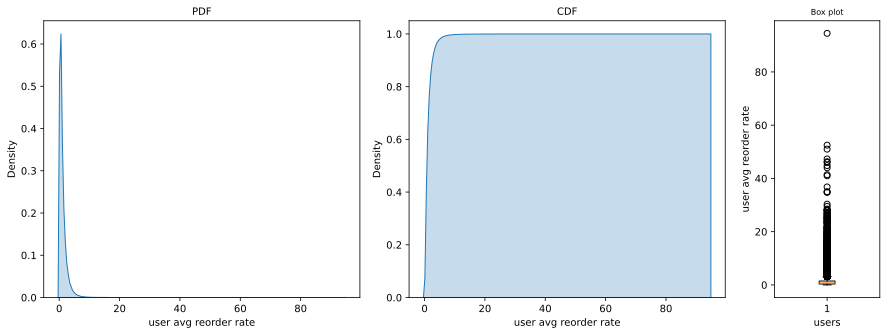

In [115]:
univariate_analysis(u_reorder_avg["u_reorder_avg"], 'user avg reorder rate')

**Conclusion/Observation**

* Users with higher avg reorder rate order fewer number of products and reorder them alot, thus they are more likely to re-order many of they prev re-ordered products in their next order.

* Users with lower avg reorder rate are less likely to re-order a product they prev re-ordered products in their next order.

In [116]:
list(u_features.columns)

['user_id',
 'num_of_orders',
 'mean_order_szie',
 'median_order_size',
 'avg_reorder_freq',
 'avg_order_size_to_re_order_freq_ratio',
 'aisles_shopped_in_count',
 'avg_prods_purchased_per_aisle',
 'cluster_3',
 'cluster_4',
 'cluster_5']

In [111]:
new_feature_name = u_reorder_avg.columns[1]
new_feature = u_reorder_avg
if new_feature_name in list(u_features.columns):
  #Overwrite
  decision = input("Do you wanna overwrite this feature: 1=> Yes, 0=> No")
  if int(decision):
    u_features = u_features.drop(new_feature_name, axis=1)
    u_features = pd.merge(u_features, new_feature, on='user_id',how='left')
    print("Overwritting")
  else:
  #Create new duploicate column
    print("Creative new duplicate column with almost same name")
    u_features = pd.merge(u_features, new_feature, on='user_id',how='left')

else:
  #Just add the new column
  u_features = pd.merge(u_features, new_feature, on='user_id',how='left')
u_features

Do you wanna overwrite this feature: 1=> Yes, 0=> No1
Overwritting


,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4,2.277778
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0,0.911765
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4,1.666667
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4,0.058824
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4,0.608696
...,...,...,...,...,...,...,...,...,...,...,...,...
206204,206205,3,10.666667,8.0,21.666667,0.369231,17,1.882353,1,1,4,0.333333
206205,206206,67,4.253731,4.0,5.042705,0.793225,50,5.700000,0,2,3,0.900000
206206,206207,16,13.937500,13.0,15.879397,0.818671,46,4.847826,2,0,1,1.423913
206207,206208,49,13.816327,13.0,8.442105,1.539900,63,10.746032,0,2,3,2.419192


In [118]:
# Adding it to other user features.

u_features = add_user_feature(u_features, u_reorder_avg)


before adding feature (206209, 12)
Do you wanna overwrite this feature: 1=> Yes, 0=> No1
Overwritting


,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4,2.277778
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0,0.911765
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4,1.666667
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4,0.058824
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4,0.608696


### **f2) User last n orders avg days gap**



Formula: for n= 3


$$\frac{\text{Count Of gap between prior n orders}}{\text{n}} $$


In [119]:
u_orders =  merg_df_prior[['user_id','order_id','order_number','days_since_prior_order']].drop_duplicates(keep = 'last').sort_values(by = ['user_id','order_number'])
u_orders[u_orders['user_id']==1]

,user_id,order_id,order_number,days_since_prior_order
24076664,1,2539329,1,NaN
22742744,1,2398795,2,15.0
4488095,1,473747,3,21.0
21376074,1,2254736,4,29.0
4089398,1,431534,5,28.0
31927070,1,3367565,6,19.0
5212927,1,550135,7,20.0
29474806,1,3108588,8,14.0
21760446,1,2295261,9,0.0
24181266,1,2550362,10,30.0


In [120]:
n = 3
u_last_n_orders = u_orders.groupby(by = ['user_id']).tail(n)
u_last_n_orders.head()

,user_id,order_id,order_number,days_since_prior_order
29474806,1,3108588,8,14.0
21760446,1,2295261,9,0.0
24181266,1,2550362,10,30.0
30210655,2,3186735,12,28.0
30987476,2,3268552,13,30.0


In [121]:
u_last_n_orders_avg_days_gap = u_last_n_orders.groupby(by = ['user_id']).agg({'days_since_prior_order':['mean']})['days_since_prior_order'].reset_index()
u_last_n_orders_avg_days_gap.rename(columns={'mean':'u_last_n_orders_avg_days_gap'}, inplace=True)
u_last_n_orders_avg_days_gap

,user_id,u_last_n_orders_avg_days_gap
0,1,14.666667
1,2,23.666667
2,3,14.333333
3,4,12.000000
4,5,13.333333
...,...,...
206204,206205,20.000000
206205,206206,11.666667
206206,206207,9.666667
206207,206208,7.000000


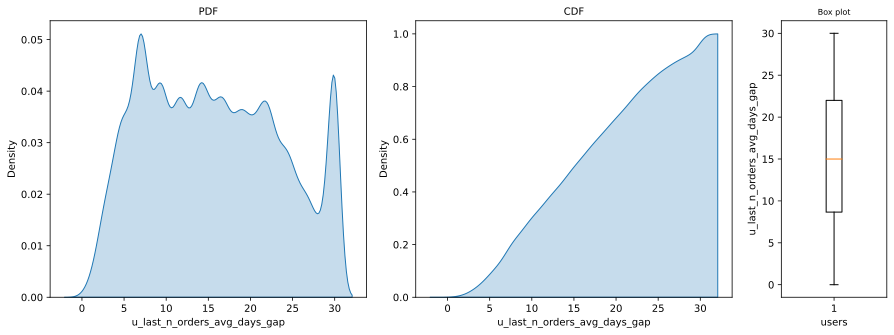

In [122]:
univariate_analysis(u_last_n_orders_avg_days_gap["u_last_n_orders_avg_days_gap"], 'u_last_n_orders_avg_days_gap')

**Conclusion/Observation**

In [123]:
## Adding it to other user features.

u_features = add_user_feature(u_features, u_last_n_orders_avg_days_gap)

before adding feature (206209, 12)


,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg,u_last_n_orders_avg_days_gap
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4,2.277778,14.666667
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0,0.911765,23.666667
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4,1.666667,14.333333
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4,0.058824,12.000000
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4,0.608696,13.333333


### **f3) Days since prior order**


Formula: for n= 1


$$\frac{\text{Count Of gap between prior n orders}}{\text{n}} $$

In [124]:
n = 1

u_orders =  merg_df_prior[['user_id','order_id','order_number','days_since_prior_order']].drop_duplicates(keep = 'last').sort_values(by = ['user_id','order_number'])
u_last_n_orders = u_orders.groupby(by = ['user_id']).tail(n)

u_days_since_prior_order = u_last_n_orders.groupby(by = ['user_id']).agg({'days_since_prior_order':['mean']})['days_since_prior_order'].reset_index()
u_days_since_prior_order.rename(columns={'mean':'days_since_prior_order'}, inplace=True)
u_days_since_prior_order

,user_id,days_since_prior_order
0,1,30.0
1,2,13.0
2,3,15.0
3,4,0.0
4,5,19.0
...,...,...
206204,206205,10.0
206205,206206,11.0
206206,206207,18.0
206207,206208,7.0


In [125]:
u_orders =  merg_df_prior[['user_id','order_id','order_number','days_since_prior_order']].drop_duplicates(keep = 'last').sort_values(by = ['user_id','order_number'])
u_orders[u_orders['user_id']==4]

,user_id,order_id,order_number,days_since_prior_order
31695754,4,3343014,1,NaN
19249954,4,2030307,2,19.0
6547608,4,691089,3,21.0
897542,4,94891,4,15.0
24252821,4,2557754,5,0.0


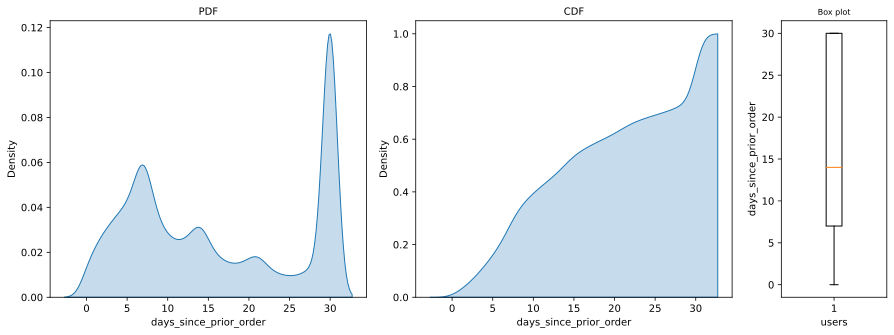

In [126]:
univariate_analysis(u_days_since_prior_order['days_since_prior_order'], 'days_since_prior_order')

**Observations/Conclusions**

* Users that have placed their last order a week or a month or half month ago, is more likely to have come for a refill their groceries, because people mostly buy groceries to last them a week or a month.
* Whereas a customer that placed last order on random days before is more difficult to predict if he is going to reorder a particular product or not.

In [127]:
## Adding it to other user features.

u_features = add_user_feature(u_features, u_days_since_prior_order)

before adding feature (206209, 13)


,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg,u_last_n_orders_avg_days_gap,days_since_prior_order
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4,2.277778,14.666667,30.0
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0,0.911765,23.666667,13.0
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4,1.666667,14.333333,15.0
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4,0.058824,12.000000,0.0
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4,0.608696,13.333333,19.0


### **f4) Average size of last n orders of user**


Formula: for n= 3


$$\frac{\text{sum of Order size of last n orders}}{\text{n}} $$

In [128]:
u_orders = merg_df_prior[['user_id','order_id','product_id','order_number','days_since_prior_order']].drop_duplicates(keep = 'last').sort_values(by = ['user_id','order_number'])
u_orders.head(10)

,user_id,order_id,product_id,order_number,days_since_prior_order
24076668,1,2539329,26405,1,NaN
24076667,1,2539329,26088,1,NaN
24076665,1,2539329,14084,1,NaN
24076666,1,2539329,12427,1,NaN
24076664,1,2539329,196,1,NaN
22742748,1,2398795,26088,2,15.0
22742747,1,2398795,13176,2,15.0
22742749,1,2398795,13032,2,15.0
22742746,1,2398795,12427,2,15.0
22742745,1,2398795,10258,2,15.0


In [129]:
n = 3
u_last_n_orders = u_orders.groupby(by = ['user_id','order_id']).agg({'order_number':['count']})['order_number']
u_last_n_orders = u_last_n_orders.groupby(by = ['user_id']).tail(n).reset_index()
u_last_n_orders.head()

,user_id,order_id,count
0,1,2550362,9
1,1,3108588,6
2,1,3367565,4
3,2,3186735,19
4,2,3194192,14


In [130]:
u_avg_size_last_n_orders = u_last_n_orders.groupby(by = ['user_id']).agg({'count':['mean']})['count'].reset_index()
u_avg_size_last_n_orders.rename(columns={'mean':'u_avg_size_last_n_orders'}, inplace=True)
u_avg_size_last_n_orders.head()

,user_id,u_avg_size_last_n_orders
0,1,6.333333
1,2,14.000000
2,3,6.333333
3,4,3.000000
4,5,8.333333


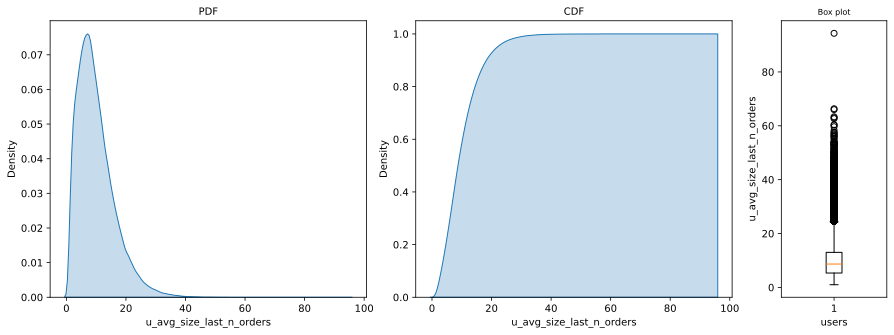

In [131]:
univariate_analysis(u_avg_size_last_n_orders['u_avg_size_last_n_orders'], 'u_avg_size_last_n_orders')

In [132]:
u_avg_size_last_n_orders

,user_id,u_avg_size_last_n_orders
0,1,6.333333
1,2,14.000000
2,3,6.333333
3,4,3.000000
4,5,8.333333
...,...,...
206204,206205,10.666667
206205,206206,3.666667
206206,206207,14.000000
206207,206208,17.333333


In [133]:
## Adding it to other user features.

u_features = add_user_feature(u_features, u_avg_size_last_n_orders)

before adding feature (206209, 14)


,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg,u_last_n_orders_avg_days_gap,days_since_prior_order,u_avg_size_last_n_orders
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4,2.277778,14.666667,30.0,6.333333
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0,0.911765,23.666667,13.0,14.000000
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4,1.666667,14.333333,15.0,6.333333
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4,0.058824,12.000000,0.0,3.000000
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4,0.608696,13.333333,19.0,8.333333


### **f5) Average size of last n orders of user by days prior ratio**


Formula: for n= 3


$$\frac{\text{u_avg_size_last_n_orders}}{\text{u_last_n_orders_avg_days_gap}} $$

In [134]:
u_features["last_n_orders_avg_size_by_num_days_ratio"] = (u_features['u_avg_size_last_n_orders']+1)/(u_features['u_last_n_orders_avg_days_gap']+1)
u_features.head()

,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg,u_last_n_orders_avg_days_gap,days_since_prior_order,u_avg_size_last_n_orders,last_n_orders_avg_size_by_num_days_ratio
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4,2.277778,14.666667,30.0,6.333333,0.468085
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0,0.911765,23.666667,13.0,14.000000,0.608108
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4,1.666667,14.333333,15.0,6.333333,0.478261
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4,0.058824,12.000000,0.0,3.000000,0.307692
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4,0.608696,13.333333,19.0,8.333333,0.651163


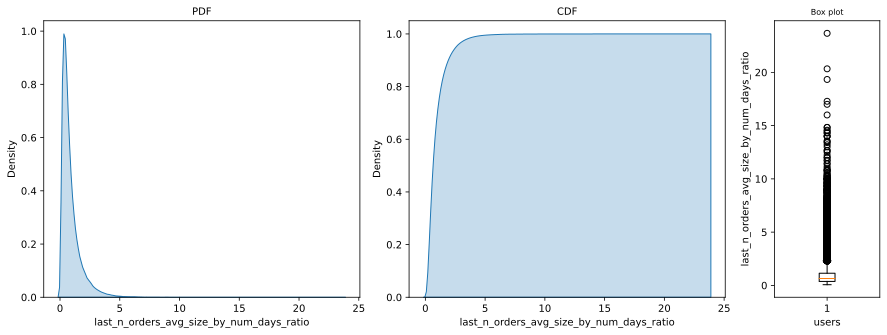

In [135]:
univariate_analysis(u_features['last_n_orders_avg_size_by_num_days_ratio'], 'last_n_orders_avg_size_by_num_days_ratio')

In [136]:
u_features[u_features['last_n_orders_avg_size_by_num_days_ratio']>5].head()

,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg,u_last_n_orders_avg_days_gap,days_since_prior_order,u_avg_size_last_n_orders,last_n_orders_avg_size_by_num_days_ratio
30,31,20,14.950000,10.5,7.073427,1.484429,48,6.229167,2,0,1,0.573684,1.333333,0.0,13.666667,6.285714
261,262,45,5.822222,5.0,7.676923,0.651303,41,6.390244,0,0,2,0.794521,1.333333,1.0,11.000000,5.142857
308,309,25,12.320000,12.0,2.129032,5.636364,38,8.105263,2,0,2,0.760000,0.333333,0.0,8.000000,6.750000
312,313,99,7.949495,7.0,3.222510,2.172220,42,18.738095,0,2,3,5.053846,0.666667,0.0,7.666667,5.200000
322,323,71,14.788732,14.0,3.520115,3.977143,37,28.378378,0,2,3,3.565217,1.000000,2.0,14.000000,7.500000


**Observation/Conclusion**

* Users with a higher ratio have bought alot on their prev 3 orders as also gap between last 3 orders is very less, thus on the next order this user is likely to reorder alot of products as well.

### **Analysis of user features created.**

**Correlation**

[]

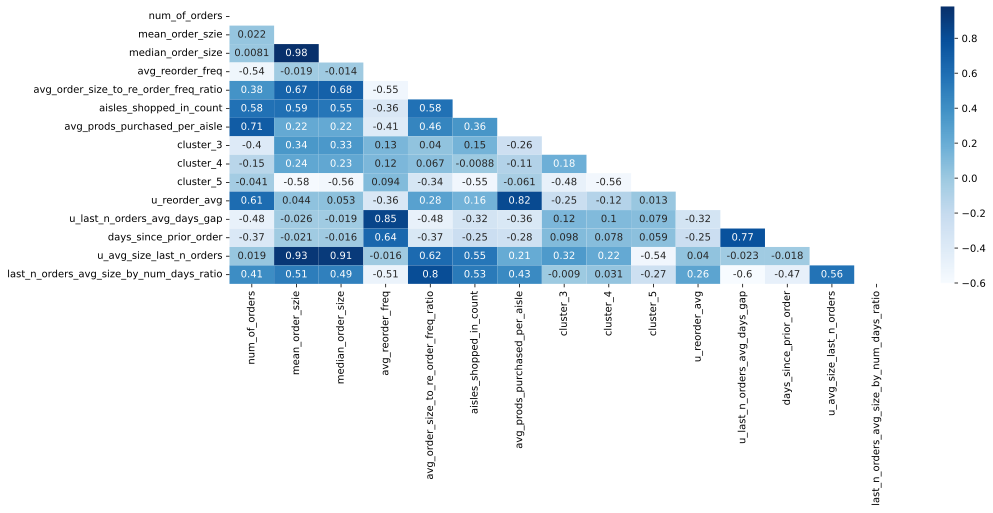

In [137]:
# calculate the correlation matrix
corr = u_features.iloc[:,1:].corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

# plot the heatmap
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,
        cmap="Blues", annot=True, mask = mask)
plt.plot()


In [138]:
#https://stackoverflow.com/questions/29294983/how-to-calculate-correlation-between-all-columns-and-remove-highly-correlated-on
threshold = 0.85
corr_matrix =  u_features.iloc[:,1:].corr().abs()
high_corr_var = np.where(corr_matrix > threshold)
[(corr_matrix.columns[x],corr_matrix.columns[y]) for x,y in zip(*high_corr_var) if x!=y and x<y]


[('mean_order_szie', 'median_order_size'),
 ('mean_order_szie', 'u_avg_size_last_n_orders'),
 ('median_order_size', 'u_avg_size_last_n_orders'),
 ('avg_reorder_freq', 'u_last_n_orders_avg_days_gap')]

In [139]:
# Dropping 1 of each highly correlated features above
u_features.drop(['mean_order_szie', 'median_order_size'], axis = 1, inplace = True)
u_features.head()

,user_id,num_of_orders,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg,u_last_n_orders_avg_days_gap,days_since_prior_order,u_avg_size_last_n_orders,last_n_orders_avg_size_by_num_days_ratio
0,1,10,21.259259,0.258711,12,4.916667,1,1,4,2.277778,14.666667,30.0,6.333333,0.468085
1,2,14,16.967033,0.795661,33,5.909091,2,3,0,0.911765,23.666667,13.0,14.000000,0.608108
2,3,12,12.487179,0.560575,16,5.500000,1,1,4,1.666667,14.333333,15.0,6.333333,0.478261
3,4,5,16.357143,0.183406,14,1.285714,1,1,4,0.058824,12.000000,0.0,3.000000,0.307692
4,5,4,15.500000,0.645161,16,2.312500,1,1,4,0.608696,13.333333,19.0,8.333333,0.651163


[]

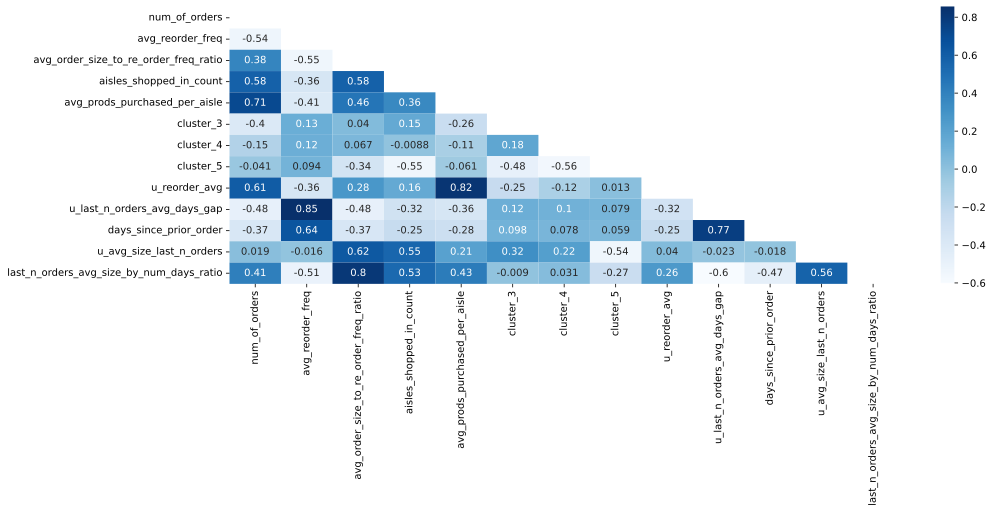

In [140]:
# calculate the correlation matrix
corr = u_features.iloc[:,1:].corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

# plot the heatmap
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,
        cmap="Blues", annot=True, mask = mask)
plt.plot()

In [141]:
#https://stackoverflow.com/questions/29294983/how-to-calculate-correlation-between-all-columns-and-remove-highly-correlated-on
threshold = 0.80
corr_matrix =  u_features.iloc[:,1:].corr().abs()
high_corr_var = np.where(corr_matrix > threshold)
[(corr_matrix.columns[x],corr_matrix.columns[y]) for x,y in zip(*high_corr_var) if x!=y and x<y]

[('avg_reorder_freq', 'u_last_n_orders_avg_days_gap'),
 ('avg_order_size_to_re_order_freq_ratio',
  'last_n_orders_avg_size_by_num_days_ratio'),
 ('avg_prods_purchased_per_aisle', 'u_reorder_avg')]

**Theres are still some multicollinearity among features, as few of them have been derived from the other. (>0.80)**

- 'avg_reorder_freq' ======== 'u_last_n_orders_avg_days_gap'
- 'avg_order_size_to_re_order_freq_ratio' ========'last_n_orders_avg_size_by_num_days_ratio'
- 'avg_prods_purchased_per_aisle' ========  'u_reorder_avg'


Note: We will still keep them for now

### **Saving user features**

In [142]:
# Saving progress so far
import shutil

u_features.to_csv('/content/user_features.csv')
shutil.copy("/content/user_features.csv", "/content/drive/MyDrive/assignment datsets")

'/content/drive/MyDrive/assignment datsets/user_features.csv'

## **Product Features**

### **f1) Average reorder ratio**



$$\frac{\text{total times the product was reordered}}{\text{total orders placed by all users}} $$

In [ ]:
p_reorder_ratio = merg_df_prior.groupby(by=['product_id']).agg({"reordered":"mean"})['reordered'].reset_index()
product_features = p_reorder_ratio.copy()
product_features.rename(columns = {"reordered":"p_reorder_ratio"}, inplace = True)
product_features.head()

,product_id,p_reorder_ratio
0,1,0.613391
1,2,0.133333
2,3,0.732852
3,4,0.446809
4,5,0.600000


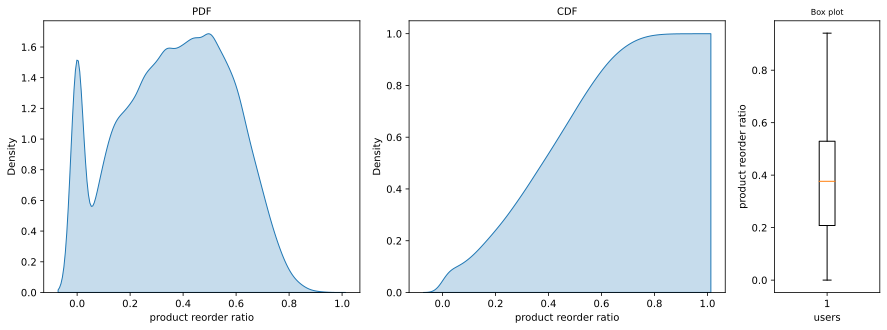

In [ ]:
univariate_analysis(product_features["p_reorder_ratio"], 'product reorder ratio')

**Which products have the lowest and  highest reorder ratio ?**

In [ ]:
maxx = product_features[product_features["p_reorder_ratio"] == product_features["p_reorder_ratio"].max()]['product_id'].values[0]
minn = product_features[product_features["p_reorder_ratio"] == product_features["p_reorder_ratio"].min()]['product_id'].values[0]

In [ ]:
print("Most reordered product with reorder_ratio = 0.94 , is: ")
merg_df_prior[merg_df_prior['product_id']==maxx].head(1)[['product_name','aisle','department']]

Most reordered product with reorder_ratio = 0.94 , is: 


,product_name,aisle,department
10099426,Raw Veggie Wrappers,prepared meals,deli


In [ ]:
print("Least reordered product with reorder_ratio = 0 , is: ")
merg_df_prior[merg_df_prior['product_id']==minn].head(1)[['product_name','aisle','department']]

Least reordered product with reorder_ratio = 0 , is: 


,product_name,aisle,department
18300348,Gluten Free Quinoa Three Cheese & Mushroom Blend,grains rice dried goods,dry goods pasta


**Observation/conclusion**

* There are many products that have a very low reorder_ratio, these are the rare and uncommon products, these products have a very low chance of being reordered.

* There are also many products that have a very high reorder_ratio, these frequently bought products, these products have a high chance of being reordered in general.

### **f2) Product One time buy count and Product One time buy ratio**

Users that bought a particular product only once


formula: Product One time buy ratio = 
$$\frac{\text{Users that bought a product only once}}{\text{total unique users that bought the product}} $$

In [ ]:
times_users_bought_each_prod = merg_df_prior.groupby(by=['product_id','user_id']).agg({"reordered":"count"})['reordered'].reset_index()
times_users_bought_each_prod.head()

,product_id,user_id,reordered
0,1,138,2
1,1,709,1
2,1,764,2
3,1,777,1
4,1,825,1


In [ ]:
users_that_bought_a_prod_once = times_users_bought_each_prod[times_users_bought_each_prod['reordered'] == 1]
users_that_bought_a_prod_once.head()

,product_id,user_id,reordered
1,1,709,1
3,1,777,1
4,1,825,1
5,1,910,1
7,1,1379,1


In [ ]:
users_that_bought_a_prod_once = users_that_bought_a_prod_once.groupby(by=['product_id']).agg({"reordered":"sum"}).reset_index()
users_that_bought_a_prod_once = users_that_bought_a_prod_once.rename(columns = {"reordered":"p_one_time_buy_count"})
users_that_bought_a_prod_once.head()


,product_id,p_one_time_buy_count
0,1,440
1,2,70
2,3,38
3,4,118
4,5,2


In [ ]:
# Number of unique customers per product
unique_customers_per_prod = times_users_bought_each_prod.groupby(by=['product_id']).agg({"reordered":"count"}).reset_index()
unique_customers_per_prod.rename(columns = {"reordered":"unique_customers_per_prod"}, inplace=True)
unique_customers_per_prod.head()

,product_id,unique_customers_per_prod
0,1,716
1,2,78
2,3,74
3,4,182
4,5,6


In [ ]:
users_that_bought_a_prod_once = pd.merge(users_that_bought_a_prod_once, unique_customers_per_prod, on = 'product_id', how = 'left')
users_that_bought_a_prod_once.head()

,product_id,p_one_time_buy_count,unique_customers_per_prod
0,1,440,716
1,2,70,78
2,3,38,74
3,4,118,182
4,5,2,6


In [ ]:
users_that_bought_a_prod_once['one_time_buy_ratio'] = users_that_bought_a_prod_once['p_one_time_buy_count'] / users_that_bought_a_prod_once['unique_customers_per_prod']
users_that_bought_a_prod_once.head()

,product_id,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio
0,1,440,716,0.614525
1,2,70,78,0.897436
2,3,38,74,0.513514
3,4,118,182,0.648352
4,5,2,6,0.333333


products 3 has been bought only once 38 times.

In [ ]:
#Adding it to existing product features
product_features = pd.merge(product_features, users_that_bought_a_prod_once, on = 'product_id', how = 'left')
product_features = product_features.fillna(0) # Product that were never just ordered once have to have ratio = 0
product_features.head()

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio
0,1,0.613391,440.0,716.0,0.614525
1,2,0.133333,70.0,78.0,0.897436
2,3,0.732852,38.0,74.0,0.513514
3,4,0.446809,118.0,182.0,0.648352
4,5,0.600000,2.0,6.0,0.333333


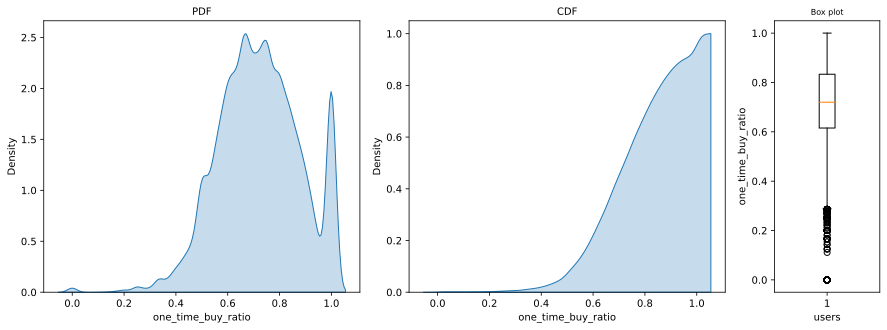

In [ ]:
univariate_analysis(product_features["one_time_buy_ratio"], 'one_time_buy_ratio')

In [ ]:
pd.merge(product_features[product_features['one_time_buy_ratio']==0].head(), products_df, on=['product_id'], how='left')

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,product_name,aisle_id,department_id
0,414,0.705882,0.0,0.0,0.0,Gluten Free Chicken Rustica Pizza,79,1
1,764,0.500000,0.0,0.0,0.0,Classic Butter Microwave Popcorn,23,19
2,802,0.851852,0.0,0.0,0.0,Organic Super Berry Juice,31,7
3,832,0.666667,0.0,0.0,0.0,High Protein Chocolate Light Milk Shake,65,11
4,2107,0.642857,0.0,0.0,0.0,Caramel Apple Filled Hard Candies,45,19


In [ ]:
print("Few products that were bought only once by many customers")
pd.merge(product_features[product_features['p_one_time_buy_count'] >15000].head(), products_df, on=['product_id'], how='left')

Few products that were bought only once by many customers


,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,product_name,aisle_id,department_id
0,13176,0.832555,18306.0,63537.0,0.288116,Bag of Organic Bananas,24,4
1,16797,0.698155,18700.0,43149.0,0.433382,Strawberries,24,4
2,21137,0.777704,20707.0,58838.0,0.351932,Organic Strawberries,24,4
3,21903,0.772500,18480.0,55037.0,0.335774,Organic Baby Spinach,123,4
4,24852,0.843501,18790.0,73956.0,0.254070,Banana,24,4


**Observations/Conclusions**

* Only a very few amont of products have been ordered only once, these products are most likely one time buys i.e people do not buy them more than once. Eg. 57 Steak Sauce. Either these products are normally bought only once or the product itself is very bad, so people once they buy it do not go for it again .

* There are few products that have one time ratio = 0. This means this product was always reordered by all users that bought it.

### **Analysis of product features created.**

**Correlation**

[]

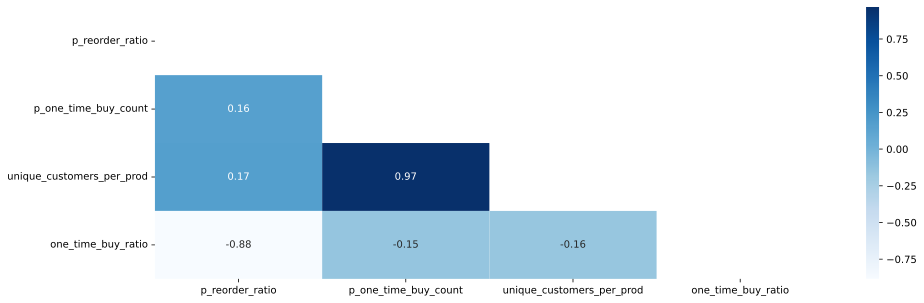

In [ ]:
# calculate the correlation matrix
corr = product_features.iloc[:,1:].corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

# plot the heatmap
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,
        cmap="Blues", annot=True, mask = mask)
plt.plot()


In [ ]:
#https://stackoverflow.com/questions/29294983/how-to-calculate-correlation-between-all-columns-and-remove-highly-correlated-on
threshold = 0.85
corr_matrix =  product_features.iloc[:,1:].corr().abs()
high_corr_var = np.where(corr_matrix > threshold)
[(corr_matrix.columns[x],corr_matrix.columns[y]) for x,y in zip(*high_corr_var) if x!=y and x<y]


[('p_reorder_ratio', 'one_time_buy_ratio'),
 ('p_one_time_buy_count', 'unique_customers_per_prod')]

In [ ]:
# Dropping only unique_customers_per_prod, even tho p_reorder_ratio', 'one_time_buy_ratio are highly corelated as well
product_features.drop(['unique_customers_per_prod'], axis = 1, inplace = True)
product_features.head()

,product_id,p_reorder_ratio,p_one_time_buy_count,one_time_buy_ratio
0,1,0.613391,440.0,0.614525
1,2,0.133333,70.0,0.897436
2,3,0.732852,38.0,0.513514
3,4,0.446809,118.0,0.648352
4,5,0.600000,2.0,0.333333


### **Saving product features**

In [ ]:
# Saving progress so far
import shutil

product_features.to_csv('/content/product_features.csv')
shutil.copy("/content/product_features.csv", "/content/drive/MyDrive/assignment datsets")

## **User product Product Features**

### **f1) Average times product was bought by user in his last n = 10 orders**


In [ ]:
uxp_features = dataset[['user_id','product_id']]
uxp_features.head() 

,user_id,product_id
0,1,196
1,1,10258
2,1,10326
3,1,12427
4,1,13032


In [ ]:
# Getting only relavent data
u_orders = merg_df_prior[['user_id','order_id','product_id','order_number']].drop_duplicates(keep = 'last').sort_values(by = ['user_id','order_number'])
u_orders.head()

,user_id,order_id,product_id,order_number
24076668,1,2539329,26405,1
24076667,1,2539329,26088,1
24076665,1,2539329,14084,1
24076666,1,2539329,12427,1
24076664,1,2539329,196,1


In [ ]:
# Reversing order_number and storing it as order_number_reverse
u_orders['order_number_reverse'] = u_orders.groupby(by=['user_id'])['order_number'].transform(max) - u_orders['order_number'] + 1
u_orders.head()

,user_id,order_id,product_id,order_number,order_number_reverse
24076668,1,2539329,26405,1,10
24076667,1,2539329,26088,1,10
24076665,1,2539329,14084,1,10
24076666,1,2539329,12427,1,10
24076664,1,2539329,196,1,10


In [ ]:
# Picking only last n orders
num_of_prior_orders = 5
u_last_n_orders = u_orders[u_orders['order_number_reverse'] <= num_of_prior_orders ]
u_last_n_orders.head()

,user_id,order_id,product_id,order_number,order_number_reverse
31927073,1,3367565,25133,6,5
31927071,1,3367565,12427,6,5
31927072,1,3367565,10258,6,5
31927070,1,3367565,196,6,5
5212930,1,550135,25133,7,4


In [ ]:
u_last_n_orders = u_last_n_orders.groupby(by = ['user_id','product_id']).agg({"order_number_reverse":"count"}).reset_index()
u_last_n_orders.rename(columns = {"order_number_reverse":"uxp_last_n_orders_ratio"}, inplace = True)
u_last_n_orders['uxp_last_n_orders_ratio']  = u_last_n_orders['uxp_last_n_orders_ratio'] / num_of_prior_orders

In [ ]:
# Adding feature
uxp_features = pd.merge(uxp_features, u_last_n_orders, on=['user_id','product_id'], how='left')
uxp_features = uxp_features.fillna(0)

uxp_features.head()

,user_id,product_id,uxp_last_n_orders_ratio
0,1,196,1.0
1,1,10258,1.0
2,1,10326,0.0
3,1,12427,1.0
4,1,13032,0.4


In [ ]:
# univariate_analysis(uxp_features["uxp_last_n_orders_ratio"], 'uxp_last_n_orders_ratio')

**Observation/Conclusion**

* Very few people bought a particular product on all their previous 10 orders.
* Majority of people bought a particular product only once in the last 10 orders.

### **f2) Average times product was bought by user in all orders**


In [ ]:
# Getting only relavent data
u_orders = merg_df_prior[['user_id','order_id','product_id','order_number']].drop_duplicates(keep = 'last').sort_values(by = ['user_id','order_number'])
u_orders['temp'] = 1
u_orders.head()

,user_id,order_id,product_id,order_number,temp
24076668,1,2539329,26405,1,1
24076667,1,2539329,26088,1,1
24076665,1,2539329,14084,1,1
24076666,1,2539329,12427,1,1
24076664,1,2539329,196,1,1


In [ ]:
t = u_orders.groupby(by = ['user_id','order_id']).agg({"temp":"count"}).reset_index()
num_orders_per_user = t.groupby(by = ['user_id']).agg({"order_id":"count"}).reset_index()
num_orders_per_user.rename(columns = {"order_id":"num_orders_per_user"},inplace = True)
num_orders_per_user.head()

,user_id,num_orders_per_user
0,1,10
1,2,14
2,3,12
3,4,5
4,5,4


In [ ]:
times_user_bought_prod  = u_orders.groupby(by = ['user_id','product_id']).agg({"temp":"count"}).reset_index()
times_user_bought_prod.head()

,user_id,product_id,temp
0,1,196,10
1,1,10258,9
2,1,10326,1
3,1,12427,10
4,1,13032,3


In [ ]:
t = pd.merge(times_user_bought_prod, num_orders_per_user, on=['user_id'], how='left')
t['uxp_avg_times_prod_bought'] = t['temp']/t['num_orders_per_user']
avg_times_prod_bought = t.copy()
avg_times_prod_bought.drop(columns = ['temp','num_orders_per_user'],inplace = True)
avg_times_prod_bought.head()

,user_id,product_id,uxp_avg_times_prod_bought
0,1,196,1.0
1,1,10258,0.9
2,1,10326,0.1
3,1,12427,1.0
4,1,13032,0.3


In [ ]:
# Adding feature
uxp_features = pd.merge(uxp_features, avg_times_prod_bought, on=['user_id','product_id'], how='left')
uxp_features.head()

,user_id,product_id,uxp_last_n_orders_ratio,uxp_avg_times_prod_bought
0,1,196,1.0,1.0
1,1,10258,1.0,0.9
2,1,10326,0.0,0.1
3,1,12427,1.0,1.0
4,1,13032,0.4,0.3


In [ ]:
# # Saving progress so far
# import shutil

# uxp_features.to_csv('/content/user_prod_features.csv')
# shutil.copy("/content/user_prod_features.csv", "/content/drive/MyDrive/assignment datsets")

### **f3) Probability of ordering a product on next order**



$$\frac{\text{total times user bought a product}}{\text{number of orders he placed after the products 1st purchase(including the 1st order) + 1}} $$

In [ ]:
# Getting only relavent data
u_orders = merg_df_prior[['user_id','order_id','product_id','order_number']].drop_duplicates(keep = 'last').sort_values(by = ['user_id','order_number'])
u_orders.head()

,user_id,order_id,product_id,order_number
24076668,1,2539329,26405,1
24076667,1,2539329,26088,1
24076665,1,2539329,14084,1
24076666,1,2539329,12427,1
24076664,1,2539329,196,1


In [ ]:
# times user bought  a prod
times_user_bought_prod  = u_orders.groupby(by = ['user_id','product_id']).agg({"order_number":"count"}).reset_index()
times_user_bought_prod.rename(columns = {"order_number":"times_user_bought_prod"},inplace = True)
times_user_bought_prod.head()

,user_id,product_id,times_user_bought_prod
0,1,196,10
1,1,10258,9
2,1,10326,1
3,1,12427,10
4,1,13032,3


In [ ]:
# Reversing order_number and storing it as order_number_reverse
u_orders['order_number_reverse'] = u_orders.groupby(by=['user_id'])['order_number'].transform(max) - u_orders['order_number'] + 1
u_orders.head()

,user_id,order_id,product_id,order_number,order_number_reverse
24076668,1,2539329,26405,1,10
24076667,1,2539329,26088,1,10
24076665,1,2539329,14084,1,10
24076666,1,2539329,12427,1,10
24076664,1,2539329,196,1,10


In [ ]:
t = u_orders.drop(columns = ['order_id','order_number']).groupby(by = ['user_id','product_id']).agg({'order_number_reverse':'max'}).reset_index()
t.rename(columns = {"order_number_reverse":"order_placed_since_prod_1st_bought"}, inplace = True)

# Total number of orders placed by users + 1, to a account for the next order.
t['order_placed_since_prod_1st_bought'] = t['order_placed_since_prod_1st_bought'] + 1
t.head()

,user_id,product_id,order_placed_since_prod_1st_bought
0,1,196,11
1,1,10258,10
2,1,10326,7
3,1,12427,11
4,1,13032,10


In [ ]:
t = pd.merge(t, times_user_bought_prod, on=['user_id','product_id'], how='left')
t['prob_of_ordering_on_next_order'] = t['times_user_bought_prod'] / t['order_placed_since_prod_1st_bought'] 
t.head()

,user_id,product_id,order_placed_since_prod_1st_bought,times_user_bought_prod,prob_of_ordering_on_next_order
0,1,196,11,10,0.909091
1,1,10258,10,9,0.900000
2,1,10326,7,1,0.142857
3,1,12427,11,10,0.909091
4,1,13032,10,3,0.300000


**Observation/Conclusions**

In [ ]:
t[t['prob_of_ordering_on_next_order']==t['prob_of_ordering_on_next_order'].max()]

,user_id,product_id,order_placed_since_prod_1st_bought,times_user_bought_prod,prob_of_ordering_on_next_order
1154185,17997,4210,100,99,0.99
2657218,41356,6583,100,99,0.99
2657236,41356,14366,100,99,0.99
2657275,41356,38652,100,99,0.99
9158533,141736,25133,100,99,0.99


In [ ]:
t[t['prob_of_ordering_on_next_order']==t['prob_of_ordering_on_next_order'].min()].head()

,user_id,product_id,order_placed_since_prod_1st_bought,times_user_bought_prod,prob_of_ordering_on_next_order
20124,310,4210,100,1,0.01
20208,310,35199,100,1,0.01
20297,313,3142,100,1,0.01
20385,313,40268,100,1,0.01
43334,690,22220,100,1,0.01


In [ ]:
# univariate_analysis(uxp_features["uxp_last_n_orders_ratio"], 'uxp_last_n_orders_ratio')

In [ ]:
# Adding feature
uxp_features = pd.merge(uxp_features, t[['user_id','product_id','prob_of_ordering_on_next_order']], on=['user_id','product_id'], how='left')
uxp_features.head()

,user_id,product_id,uxp_last_n_orders_ratio,uxp_avg_times_prod_bought,prob_of_ordering_on_next_order
0,1,196,1.0,1.0,0.909091
1,1,10258,1.0,0.9,0.900000
2,1,10326,0.0,0.1,0.142857
3,1,12427,1.0,1.0,0.909091
4,1,13032,0.4,0.3,0.300000


In [ ]:
# # Saving progress so far
# import shutil

# uxp_features.to_csv('/content/user_prod_features.csv')
# shutil.copy("/content/user_prod_features.csv", "/content/drive/MyDrive/assignment datsets")

### **f4) Days since user last bought the product**



$$\frac{\text{total times user bought a product}}{\text{number of orders he placed after the products 1st purchase(including the 1st order) + 1}} $$

In [ ]:
u_prod_orders = merg_df_prior[['user_id','order_id','product_id','order_number','days_since_prior_order']].sort_values(['user_id','order_number'])
u_prod_orders.head()

,user_id,order_id,product_id,order_number,days_since_prior_order
24076668,1,2539329,26405,1,NaN
24076667,1,2539329,26088,1,NaN
24076665,1,2539329,14084,1,NaN
24076666,1,2539329,12427,1,NaN
24076664,1,2539329,196,1,NaN


In [ ]:
u_orders = u_prod_orders.groupby(by=['user_id','order_id'], sort=False).agg({"days_since_prior_order":"mean"}).reset_index()
u_orders.head()

,user_id,order_id,days_since_prior_order
0,1,2539329,NaN
1,1,2398795,15.0
2,1,473747,21.0
3,1,2254736,29.0
4,1,431534,28.0


In [ ]:
#https://stackoverflow.com/questions/46303570/pandas-python-groupby-cummulative-sum-reverse
u_orders = u_orders.groupby(by=['user_id','order_id'], sort=False).sum()
u_orders['uxp_days_since_prior_order_cumsum_rev'] = u_orders.iloc[::-1].groupby(level=[0]).cumsum()
u_orders = u_orders.reset_index()

In [ ]:
u_orders[u_orders['user_id']==1]

,user_id,order_id,days_since_prior_order,uxp_days_since_prior_order_cumsum_rev
0,1,2539329,0.0,176.0
1,1,2398795,15.0,176.0
2,1,473747,21.0,161.0
3,1,2254736,29.0,140.0
4,1,431534,28.0,111.0
5,1,3367565,19.0,83.0
6,1,550135,20.0,64.0
7,1,3108588,14.0,44.0
8,1,2295261,0.0,30.0
9,1,2550362,30.0,30.0


In [ ]:
u_prod_orders = pd.merge(u_prod_orders, u_orders[['user_id','order_id','uxp_days_since_prior_order_cumsum_rev']], on=['user_id','order_id' ], how = 'left')
u_prod_orders.head()

,user_id,order_id,product_id,order_number,days_since_prior_order,uxp_days_since_prior_order_cumsum_rev
0,1,2539329,26405,1,NaN,176.0
1,1,2539329,26088,1,NaN,176.0
2,1,2539329,14084,1,NaN,176.0
3,1,2539329,12427,1,NaN,176.0
4,1,2539329,196,1,NaN,176.0


In [ ]:
u_prod_orders = u_prod_orders.groupby(by=['user_id','product_id']).agg({"uxp_days_since_prior_order_cumsum_rev":"last"}).reset_index()
u_prod_orders.head()

In [ ]:
# Adding feature
# uxp_features = pd.merge(uxp_features, u_prod_orders, on=['user_id','product_id'], how='left')
uxp_features.head()

In [ ]:
# # Saving progress so far

# import shutil

# uxp_features.to_csv('/content/user_prod_features.csv')
# shutil.copy("/content/user_prod_features.csv", "/content/drive/MyDrive/assignment datsets")

### **Analysis of user product features created.**

**Correlation**

In [ ]:
# calculate the correlation matrix
corr = uxp_features.iloc[:,1:].corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

# plot the heatmap
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,
        cmap="Blues", annot=True, mask = mask)
plt.plot()


In [ ]:
#https://stackoverflow.com/questions/29294983/how-to-calculate-correlation-between-all-columns-and-remove-highly-correlated-on
threshold = 0.80
corr_matrix =  uxp_features.iloc[:,1:].corr().abs()
high_corr_var = np.where(corr_matrix > threshold)
[(corr_matrix.columns[x],corr_matrix.columns[y]) for x,y in zip(*high_corr_var) if x!=y and x<y]


**Theres are some multicollinearity among features, as few of them have been derived from the other. (>0.80)**

- 'uxp_last_n_orders_ratio' ========= 'prob_of_ordering_on_next_order'


Note: We will still keep them for now

#**ML Data preparation**

### **Initial setup**

In [143]:
order_prod_tr_df.head(2)

,order_id,product_id,add_to_cart_order,reordered
0,1,49302,1,1
1,1,11109,2,1


In [144]:
te_users = orders_df[orders_df['eval_set'] == 'test'][["order_id","user_id","eval_set","order_number"]]
te_users.head()

,order_id,user_id,eval_set,order_number
38,2774568,3,test,13
44,329954,4,test,6
53,1528013,6,test,4
96,1376945,11,test,8
102,1356845,12,test,6


In [145]:
dataset_te = pd.merge(dataset,te_users, on =['user_id'], how='inner')
dataset_te = dataset_te.drop(columns =['reordered_y','order_id','order_number','eval_set'])
dataset_te['user_id'].unique().shape

(75000,)

In [146]:
dataset_te.head()

,user_id,product_id,reordered_x
0,3,248,0
1,3,1005,0
2,3,1819,1
3,3,7503,0
4,3,8021,0


### **Combining all features**

In [147]:
user_features.head()

,user_id,num_of_orders,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5,u_reorder_avg,u_last_n_orders_avg_days_gap,days_since_prior_order,u_avg_size_last_n_orders,last_n_orders_avg_size_by_num_days_ratio
0,1,10,21.259259,0.258711,12,4.916667,1,1,4,2.277778,14.666667,30.0,6.333333,0.468085
1,2,14,16.967033,0.795661,33,5.909091,2,3,0,0.911765,23.666667,13.0,14.000000,0.608108
2,3,12,12.487179,0.560575,16,5.500000,1,1,4,1.666667,14.333333,15.0,6.333333,0.478261
3,4,5,16.357143,0.183406,14,1.285714,1,1,4,0.058824,12.000000,0.0,3.000000,0.307692
4,5,4,15.500000,0.645161,16,2.312500,1,1,4,0.608696,13.333333,19.0,8.333333,0.651163


In [148]:
product_features.head()

,product_id,p_reorder_ratio,p_one_time_buy_count,one_time_buy_ratio
0,1,0.613391,440.0,0.614525
1,2,0.133333,70.0,0.897436
2,3,0.732852,38.0,0.513514
3,4,0.446809,118.0,0.648352
4,5,0.600000,2.0,0.333333


In [149]:
uxp_features.head()

,user_id,product_id,uxp_last_n_orders_ratio,uxp_avg_times_prod_bought,prob_of_ordering_on_next_order,uxp_days_since_prior_order_cumsum_rev
0,1,196,1.0,1.0,0.909091,30.0
1,1,10258,1.0,0.9,0.900000,30.0
2,1,10326,0.0,0.1,0.142857,111.0
3,1,12427,1.0,1.0,0.909091,30.0
4,1,13032,0.4,0.3,0.300000,30.0


In [150]:
# Merging user features, product features, user - product features

all_features_tr = pd.merge(
                            pd.merge(
                                     pd.merge(dataset, user_features, on = 'user_id', how = 'left'),
                            product_features, on = 'product_id', how = 'left'), 
                  uxp_features, on = ['user_id','product_id'], how = 'left')

all_features_tr.head()

,user_id,product_id,reordered_x,reordered_y,num_of_orders,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,...,days_since_prior_order,u_avg_size_last_n_orders,last_n_orders_avg_size_by_num_days_ratio,p_reorder_ratio,p_one_time_buy_count,one_time_buy_ratio,uxp_last_n_orders_ratio,uxp_avg_times_prod_bought,prob_of_ordering_on_next_order,uxp_days_since_prior_order_cumsum_rev
0,1,196,1,1.0,10,21.259259,0.258711,12,4.916667,1,...,30.0,6.333333,0.468085,0.776480,3340.0,0.417500,1.0,1.0,0.909091,30.0
1,1,10258,1,1.0,10,21.259259,0.258711,12,4.916667,1,...,30.0,6.333333,0.468085,0.713772,249.0,0.447038,1.0,0.9,0.900000,30.0
2,1,10326,0,0.0,10,21.259259,0.258711,12,4.916667,1,...,30.0,6.333333,0.468085,0.652009,920.0,0.478419,0.0,0.1,0.142857,111.0
3,1,12427,1,0.0,10,21.259259,0.258711,12,4.916667,1,...,30.0,6.333333,0.468085,0.740735,790.0,0.470518,1.0,1.0,0.909091,30.0
4,1,13032,1,1.0,10,21.259259,0.258711,12,4.916667,1,...,30.0,6.333333,0.468085,0.657158,669.0,0.520218,0.4,0.3,0.300000,30.0


In [151]:
# Merging user features, product features, user - product features

all_features_te = pd.merge(
                            pd.merge(
                                     pd.merge(dataset_te, user_features, on = 'user_id', how = 'left'),
                            product_features, on = 'product_id', how = 'left'), 
                  uxp_features, on = ['user_id','product_id'], how = 'left')

all_features_te.head()

,user_id,product_id,reordered_x,num_of_orders,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,...,days_since_prior_order,u_avg_size_last_n_orders,last_n_orders_avg_size_by_num_days_ratio,p_reorder_ratio,p_one_time_buy_count,one_time_buy_ratio,uxp_last_n_orders_ratio,uxp_avg_times_prod_bought,prob_of_ordering_on_next_order,uxp_days_since_prior_order_cumsum_rev
0,3,248,0,12,12.487179,0.560575,16,5.5,1,1,...,15.0,6.333333,0.478261,0.400251,2753.0,0.720492,0.0,0.083333,0.083333,133.0
1,3,1005,0,12,12.487179,0.560575,16,5.5,1,1,...,15.0,6.333333,0.478261,0.440605,178.0,0.687259,0.2,0.083333,0.250000,43.0
2,3,1819,1,12,12.487179,0.560575,16,5.5,1,1,...,15.0,6.333333,0.478261,0.492162,804.0,0.653128,0.0,0.250000,0.300000,64.0
3,3,7503,0,12,12.487179,0.560575,16,5.5,1,1,...,15.0,6.333333,0.478261,0.553551,3432.0,0.616269,0.0,0.083333,0.090909,124.0
4,3,8021,0,12,12.487179,0.560575,16,5.5,1,1,...,15.0,6.333333,0.478261,0.591157,6370.0,0.559164,0.0,0.083333,0.083333,133.0


In [152]:
# Cleaning data
import gc


del user_features
del uxp_features
del product_features
del merg_df_prior
del merg_df_tr

gc.collect()

19390

### **Normalizing datasets (Dont run unless ram is sufficient)**

In [ ]:
# # data standardization with  sklearn
# from sklearn.preprocessing import StandardScaler

# y = all_features_tr['reordered_y']
# scaler = StandardScaler()
# # Taking all columns except reordered_y
# scaler = scaler.fit(  all_features_tr.loc[:, all_features_tr.columns != 'reordered_y']  )

# all_features_tr = scaler.transform(  all_features_tr.loc[:, all_features_tr.columns != 'reordered_y']  )
# all_features_te = scaler.transform(  all_features_te  )

###**Random forest**

**Train test split**

In [ ]:
from sklearn.model_selection import train_test_split

y = all_features_tr['reordered_y'].values
X_train, X_test, y_train, y_test = train_test_split(all_features_tr.drop(columns = ['user_id','product_id','reordered_y']).values, y, train_size = 0.80, random_state=42)

In [ ]:
# Cleaning data
import gc

del all_features_tr
del y
gc.collect()

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

# Number of trees in random forest
n_estimators = [200, 1000]
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 100, num = 5)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}
print(random_grid)

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# model = RandomForestClassifier()
# model = RandomizedSearchCV(estimator = model, param_distributions = random_grid, n_iter = 8, cv = 3, verbose=2, random_state=42, n_jobs = -1)

model = RandomForestClassifier(n_estimators=50, criterion='gini', min_samples_split=5, n_jobs = -1,
                               min_samples_leaf=2, bootstrap=True,  max_features = 0.7, max_samples =  0.8, 
                               verbose = 2 , class_weight='balanced', random_state=42)
model.fit(X_train,y_train)
y_pred_tr = model.predict(X_train)
y_pred_te = model.predict(X_test)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.


building tree 1 of 200
building tree 2 of 200
building tree 3 of 200
building tree 4 of 200
building tree 5 of 200
building tree 6 of 200
building tree 7 of 200
building tree 8 of 200
building tree 9 of 200
building tree 10 of 200
building tree 11 of 200
building tree 12 of 200
building tree 13 of 200
building tree 14 of 200
building tree 15 of 200
building tree 16 of 200
building tree 17 of 200
building tree 18 of 200
building tree 19 of 200
building tree 20 of 200
building tree 21 of 200
building tree 22 of 200
building tree 23 of 200
building tree 24 of 200
building tree 25 of 200
building tree 26 of 200
building tree 27 of 200
building tree 28 of 200
building tree 29 of 200
building tree 30 of 200
building tree 31 of 200
building tree 32 of 200
building tree 33 of 200
building tree 34 of 200
building tree 35 of 200
building tree 36 of 200


[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed: 16.2min


building tree 37 of 200
building tree 38 of 200
building tree 39 of 200
building tree 40 of 200
building tree 41 of 200
building tree 42 of 200
building tree 43 of 200
building tree 44 of 200
building tree 45 of 200
building tree 46 of 200
building tree 47 of 200
building tree 48 of 200
building tree 49 of 200
building tree 50 of 200
building tree 51 of 200
building tree 52 of 200
building tree 53 of 200
building tree 54 of 200
building tree 55 of 200
building tree 56 of 200
building tree 57 of 200
building tree 58 of 200
building tree 59 of 200
building tree 60 of 200
building tree 61 of 200
building tree 62 of 200
building tree 63 of 200
building tree 64 of 200
building tree 65 of 200
building tree 66 of 200
building tree 67 of 200
building tree 68 of 200
building tree 69 of 200
building tree 70 of 200
building tree 71 of 200
building tree 72 of 200
building tree 73 of 200
building tree 74 of 200
building tree 75 of 200
building tree 76 of 200
building tree 77 of 200
building tree 78

[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed: 66.0min


building tree 159 of 200
building tree 160 of 200
building tree 161 of 200
building tree 162 of 200
building tree 163 of 200
building tree 164 of 200
building tree 165 of 200
building tree 166 of 200
building tree 167 of 200
building tree 168 of 200
building tree 169 of 200
building tree 170 of 200
building tree 171 of 200
building tree 172 of 200
building tree 173 of 200
building tree 174 of 200
building tree 175 of 200
building tree 176 of 200
building tree 177 of 200
building tree 178 of 200
building tree 179 of 200
building tree 180 of 200
building tree 181 of 200
building tree 182 of 200
building tree 183 of 200
building tree 184 of 200
building tree 185 of 200
building tree 186 of 200
building tree 187 of 200
building tree 188 of 200
building tree 189 of 200
building tree 190 of 200
building tree 191 of 200
building tree 192 of 200
building tree 193 of 200
building tree 194 of 200
building tree 195 of 200
building tree 196 of 200
building tree 197 of 200
building tree 198 of 200


[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed: 84.5min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  33 tasks      | elapsed:  1.1min
[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:  4.9min
[Parallel(n_jobs=4)]: Done 200 out of 200 | elapsed:  6.3min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  33 tasks      | elapsed:   15.9s
[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:  1.2min
[Parallel(n_jobs=4)]: Done 200 out of 200 | elapsed:  1.6min finished


In [ ]:
y_pred_tr_thres = (model.predict_proba(X_train)[:, 1] >= 0.18).astype('int')
y_pred_te_thres = (model.predict_proba(X_test)[:, 1] >= 0.18).astype('int')

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  33 tasks      | elapsed:  1.2min
[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:  5.0min
[Parallel(n_jobs=4)]: Done 200 out of 200 | elapsed:  6.5min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  33 tasks      | elapsed:   15.5s
[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:  1.2min
[Parallel(n_jobs=4)]: Done 200 out of 200 | elapsed:  1.6min finished


In [ ]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_train, y_pred_tr))
print(confusion_matrix(y_test, y_pred_te))

from sklearn import metrics

print("train f1:",metrics.f1_score(y_train, y_pred_tr_thres, average='binary'))
print("test f1:",metrics.f1_score(y_test, y_pred_te_thres, average='binary'))

print("train acc", metrics.accuracy_score(y_train, y_pred_tr_thres))
print("test acc" , metrics.accuracy_score(y_test, y_pred_te_thres))


[[9977044    6475]
 [ 431635  231208]]
[[2483729   11881]
 [ 153094   12887]]
train f1: 0.6826339226865279
test f1: 0.33749183750796097
train acc 0.94210886310272
test acc 0.8764956749553181


In [ ]:
univariate_analysis(model.predict_proba(X_test)[:, 1], "prob")

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  33 tasks      | elapsed:   15.4s
[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:  1.2min
[Parallel(n_jobs=4)]: Done 200 out of 200 | elapsed:  1.6min finished


In [ ]:
# Saving model
import pickle
import shutil

# save the model to disk
filename = 'rf_model.sav'
pickle.dump(model, open(filename, 'wb'))


shutil.copy("/content/rf_model.sav", "/content/drive/MyDrive/assignment datsets")


In [ ]:
# load the model from disk
model = pickle.load(open(filename, 'rb'))
result = model.score(X_test, Y_test)
print(result)

### **XGboost**

In [ ]:
from sklearn.model_selection import train_test_split

all_features_tr = all_features_tr.set_index(['user_id','product_id'])
all_features_te = all_features_te.set_index(['user_id','product_id'])

all_features_tr.head(2)

y = all_features_tr['reordered_y']
X_train, x, y_train, y = train_test_split(all_features_tr.drop(columns = ['reordered_y']), y, train_size = 0.80, random_state=42)
X_test, X_cv, y_test, y_cv = train_test_split(x, y, test_size = 0.50, random_state=42)
print("train size:",X_train.shape)
print("cv size:",X_cv.shape)
print("test size:",X_test.shape)

train size: (10646362, 21)
cv size: (1330796, 21)
test size: (1330795, 21)


In [ ]:
# Cleaning data
import gc

del all_features_tr
del y
gc.collect()

50

In [ ]:
!pip install scikit-plot
from sklearn.metrics import f1_score, classification_report
from scikitplot.classifiers import plot_feature_importances
from scikitplot.metrics import plot_confusion_matrix


import xgboost as xgb
import lightgbm as lgb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from sklearn.metrics import f1_score
import numpy as np
import numpy as np

def xgb_f1(y, t, threshold=0.21):
    t = t.get_label()
    y_bin = (y > threshold).astype(int) # works for both type(y) == <class 'numpy.ndarray'> and type(y) == <class 'pandas.core.series.Series'>
    return 'f1',f1_score(t,y_bin)

#setting boosters parameters
parameters = {'max_depth':10, 
              'silent':1,
         'nthread':27,
         'eval_metric':'logloss',
         'binary':'logistic',
         'eta':0.02,
         'colsample_bytree':0.4,
         'subsample':0.75,
         'tree_method':'hist'
}

In [ ]:
# # Cleaning data
# import gc

# del X_train
# del y_train
# del X_cv
# del y_cv
# gc.collect()

In [ ]:
#Creating a XGBoost model.
# #Initializing the model

dtrain = xgb.DMatrix(X_train, y_train)
dcv = xgb.DMatrix(X_cv, y_cv)


watchlist= [(dtrain, "train"),(dcv, "cv")]
model = xgb.train( params=parameters, verbose_eval = 10, num_boost_round=1000, dtrain=dtrain,
                  evals=watchlist , early_stopping_rounds=30) #, feval = xgb_f1


[0]	train-logloss:0.677463	cv-logloss:0.677473
Multiple eval metrics have been passed: 'cv-logloss' will be used for early stopping.

Will train until cv-logloss hasn't improved in 30 rounds.
[10]	train-logloss:0.549696	cv-logloss:0.549803
[20]	train-logloss:0.459467	cv-logloss:0.459667
[30]	train-logloss:0.393613	cv-logloss:0.393909
[40]	train-logloss:0.344855	cv-logloss:0.345237
[50]	train-logloss:0.308095	cv-logloss:0.30857
[60]	train-logloss:0.279988	cv-logloss:0.280558
[70]	train-logloss:0.258566	cv-logloss:0.259231
[80]	train-logloss:0.241984	cv-logloss:0.242751
[90]	train-logloss:0.229234	cv-logloss:0.230107
[100]	train-logloss:0.219426	cv-logloss:0.220411
[110]	train-logloss:0.211932	cv-logloss:0.213025
[120]	train-logloss:0.20606	cv-logloss:0.207265
[130]	train-logloss:0.201522	cv-logloss:0.202841
[140]	train-logloss:0.198041	cv-logloss:0.199475
[150]	train-logloss:0.195375	cv-logloss:0.196916
[160]	train-logloss:0.193315	cv-logloss:0.194964
[170]	train-logloss:0.191719	cv-log

In [ ]:
tr_log_loss = [0.549696	,0.459467	,0.393613	,0.344855	,0.308095	,0.279988	,0.258566	,0.241984	,0.229234	,0.219426	,0.211932	,0.20606	  ,0.201522	,0.198041	,0.195375	,0.193315	,0.191719	,0.190482	,0.189515	,0.188766	,0.188155	,0.187661	,0.18727	  ,0.186942	,0.186675	,0.186448	,0.186243	,0.186058	,0.1859	  ,0.185748	,0.185591	,0.185452	,0.185313	,0.185175	,0.185049	,0.18492	  ,0.184789	,0.18466	  ,0.184551	,0.184436	,0.184313	,0.18421	  ,
               0.184107	,0.183986	,0.183871	,0.183782	,0.183673	,0.183578	,0.183481	,0.183374	,0.183265	,0.183161	,0.183055	,0.182946	,0.182845	,0.182731	,0.18265	  ,0.182574	,0.182484	,0.182404	,0.182298	,0.182215	,0.182119	,0.182043	,0.18195	  ,0.181864	,0.181769	,0.18168	  ,0.181588	,0.181506	,0.181427	,0.181344	,0.181259	,0.18116	  ,0.181062	,0.180978	,0.180896	,0.180821	,0.180734	,0.180653	,0.180559	,0.18047	  ,0.180393	,0.180324	,
               0.180231	,0.180141	,0.180058	,0.179983	,0.179899	,0.179819	,0.179739	,0.179671	,0.179599	,0.179516	,0.179452	,0.179367	,0.179291	,0.179214	,0.179131	,0.179061	]

In [ ]:
cv_log_loss = [0.549803,0.459667,0.393909,0.345237,0.30857,0.280558,0.259231,0.242751,0.230107,0.220411,0.213025,0.207265,0.202841,0.199475,0.196916,0.194964,0.193475,0.192342,0.191485,0.190836,0.190331,
               0.18993,0.189631,0.189395,0.189212,0.189065,0.18894,0.188841,0.188782,0.188705,0.188628,0.188586,0.188506,0.18843,0.188357,0.188312,0.188236,0.188187,0.18814,0.188142,0.188082,0.188025,0.187968,
               0.187933,0.187878,0.187827,0.187767,0.187718,0.187666,0.187588,0.18753,0.187473,0.18742,0.187367,0.187311,0.187279,0.187243,0.187216,0.187215,0.187205,0.187149,0.18709,0.187055,0.187022,0.186982,
               0.186944,0.186881,0.186863,0.186792,0.18675,0.186759,0.186727,0.186661,0.186651,0.186545,0.186486,0.186477,0.186447,0.186401,0.186362,0.186355,0.18629,0.186269,0.186227,0.18622,0.186156,0.18609,0.186066,0.186026,0.185996,0.185979,0.18593,0.185926,0.185983,0.185987,0.185902,0.185866,0.185812,0.185817,0.185784]

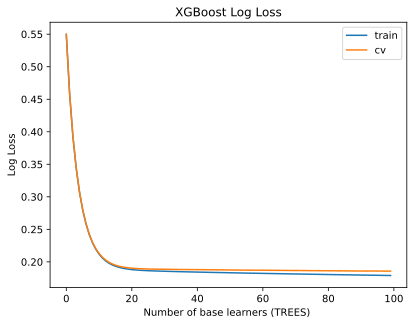

In [ ]:
#https://machinelearningmastery.com/avoid-overfitting-by-early-stopping-with-xgboost-in-python/
from matplotlib import pyplot


# retrieve performance metrics

trees = len(cv_log_loss)
x_axis = range(0, trees)
# plot log loss
fig, ax = pyplot.subplots()
ax.plot(x_axis, tr_log_loss, label='train')
ax.plot(x_axis, cv_log_loss, label='cv')
ax.legend()
pyplot.ylabel('Log Loss')
pyplot.xlabel('Number of base learners (TREES) ')
pyplot.title('XGBoost Log Loss')
pyplot.show()


**Our model doesnt seem to overfit much. If run for longer accuracy could improve.**

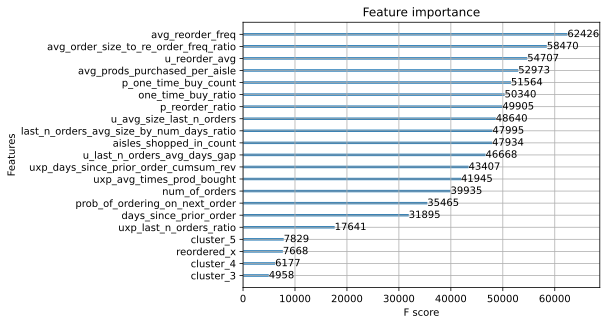

In [ ]:
from xgboost import XGBClassifier, plot_importance

plot_importance(model)

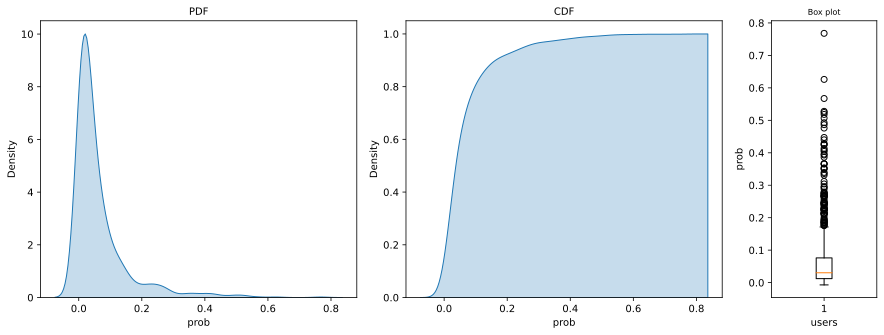

In [ ]:
import random
univariate_analysis(random.sample(list(model.predict(dtest)), 1000), "prob")

Number of misclassified points  9.164146243410894
-------------------------------------------------- Confusion matrix --------------------------------------------------


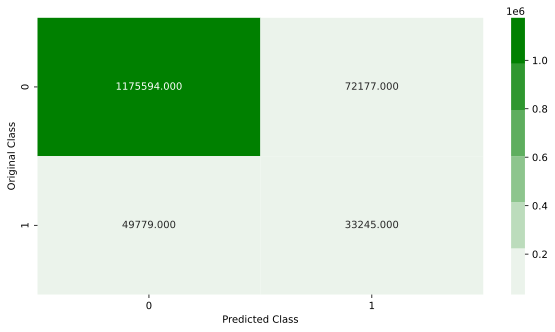

-------------------------------------------------- Recall matrix --------------------------------------------------


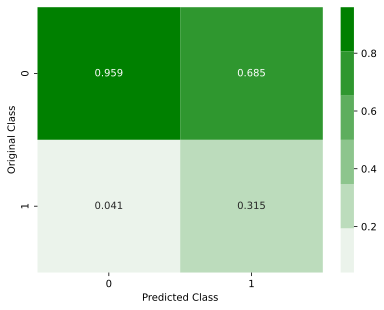

-------------------------------------------------- Precision matrix --------------------------------------------------


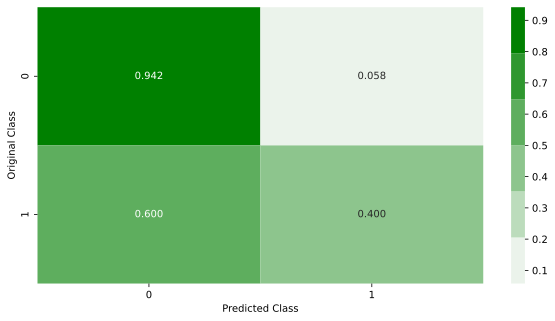

train f1: 0.3769903856972517
test f1: 0.35283317236768097
train acc 0.9121032142247276
test acc 0.908358537565891


In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn import metrics

# From above plot most of the probabilities are right tailed thus choosing 0.5 will not yield good results,
# Thus using elbow method we use 0.19 as the threshold.
threshold = 0.19

dtest = xgb.DMatrix(X_test, y_test)
y_pred_tr_thres = (model.predict(dtrain) >= threshold).astype('int')
y_pred_te_thres = (model.predict(dtest) >= threshold).astype('int')

plot_confusion_matrix(y_test, y_pred_te_thres)

print("train f1:",metrics.f1_score(y_train, y_pred_tr_thres, average='binary'))
print("test f1:",metrics.f1_score(y_test, y_pred_te_thres, average='binary'))

print("train acc", metrics.accuracy_score(y_train, y_pred_tr_thres))
print("test acc" , metrics.accuracy_score(y_test, y_pred_te_thres))


### **LGBM**

In [153]:
#importing the necessary packages.
!pip install scikit-plot
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import f1_score, classification_report
from scikitplot.metrics import plot_confusion_matrix
from scikitplot.classifiers import plot_feature_importances

#importing model packages.
import xgboost as xgb
import lightgbm as lgb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [154]:
from sklearn.model_selection import train_test_split

y = all_features_tr['reordered_y'].values
X_train, X_test, y_train, y_test = train_test_split(all_features_tr.drop(columns = ['user_id','product_id','reordered_y']).values, y, train_size = 0.80, random_state=24)
# X_test, X_cv, y_test, y_cv = train_test_split(x, y, test_size = 0.50, random_state=42)

In [155]:
# Cleaning data
import gc

del all_features_tr
del y
gc.collect()

50

In [156]:
from sklearn.metrics import f1_score, classification_report
from scikitplot.classifiers import plot_feature_importances
from scikitplot.metrics import plot_confusion_matrix

import xgboost as xgb
import lightgbm as lgb

import lightgbm as lgb
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import f1_score
import numpy as np
import numpy as np

**Hyperparam tuning**

In [ ]:
from scipy.stats import randint as sp_randint
from scipy.stats import uniform as sp_uniform
param_test ={'num_leaves': sp_randint(6, 50), 
             'min_child_samples': sp_randint(100, 500), 
             'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
             'subsample': sp_uniform(loc=0.2, scale=0.8), 
             'colsample_bytree': sp_uniform(loc=0.4, scale=0.6),
             'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
             'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}

In [ ]:
#This parameter defines the number of HP points to be tested
n_HP_points_to_test = 50

#n_estimators is set to a "large value". The actual number of trees build will depend on early stopping and 5000 define only the absolute maximum
clf = lgb.LGBMClassifier(objective='binary', max_depth=-1, random_state=314, silent=False, metric='logloss', n_jobs=-1, n_estimators=50)
gs = RandomizedSearchCV(
    estimator=clf, param_distributions=param_test, 
    n_iter=n_HP_points_to_test,
    scoring='roc_auc',
    cv=3,
    refit=True,
    random_state=314,
    verbose=10)

gs.fit(X_train, y_train)
print('Best score reached: {} with params: {} '.format(gs.best_score_, gs.best_params_))



Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3; 1/50] START colsample_bytree=0.9501241488957805, min_child_samples=301, min_child_weight=0.1, num_leaves=28, reg_alpha=0, reg_lambda=100, subsample=0.9326466073236168
[CV 1/3; 1/50] END colsample_bytree=0.9501241488957805, min_child_samples=301, min_child_weight=0.1, num_leaves=28, reg_alpha=0, reg_lambda=100, subsample=0.9326466073236168;, score=0.818 total time=  56.7s
[CV 2/3; 1/50] START colsample_bytree=0.9501241488957805, min_child_samples=301, min_child_weight=0.1, num_leaves=28, reg_alpha=0, reg_lambda=100, subsample=0.9326466073236168
[CV 2/3; 1/50] END colsample_bytree=0.9501241488957805, min_child_samples=301, min_child_weight=0.1, num_leaves=28, reg_alpha=0, reg_lambda=100, subsample=0.9326466073236168;, score=0.818 total time=  54.8s
[CV 3/3; 1/50] START colsample_bytree=0.9501241488957805, min_child_samples=301, min_child_weight=0.1, num_leaves=28, reg_alpha=0, reg_lambda=100, subsample=0.9326466073236

**Training model with optimal params**

F1 Score train: 0.3853480537034608
F1 Score test: 0.3721419876961542
              precision    recall  f1-score   support

           0       0.94      0.96      0.95   2431687
           1       0.44      0.32      0.37    229904

    accuracy                           0.91   2661591
   macro avg       0.69      0.64      0.66   2661591
weighted avg       0.89      0.91      0.90   2661591



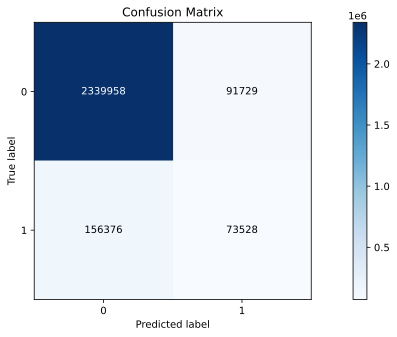

In [157]:
# #Creating a light gradient boosting model.
# # #Initializing the model


lgbm = lgb.LGBMClassifier(objective='binary', max_depth=10, verbose = 10,  n_estimators=2000,
                           colsample_bytree= 0.6947906020441199, min_child_samples= 418, min_child_weight= 0.001,
                            num_leaves= 49, reg_alpha=7, reg_lambda=10, subsample= 0.8995337058150867)

#fitting the model.
lgbm.fit(X_train, y_train)

#prediction
y_pred_tr = (lgbm.predict_proba(X_train)[:, 1] >= 0.18).astype('int') #setting a threshold.
y_pred_te = (lgbm.predict_proba(X_test)[:, 1] >= 0.18).astype('int') #setting a threshold.

#Evaluation.
print('F1 Score train: {}'.format(f1_score(y_pred_tr, y_train)))
print('F1 Score test: {}'.format(f1_score(y_pred_te, y_test)))
print(classification_report(y_pred_te, y_test))
plot_confusion_matrix(y_pred_te, y_test)

**Feature importance**

**Our model doesnt seem to overfit much. If run for longer accuracy could improve.**

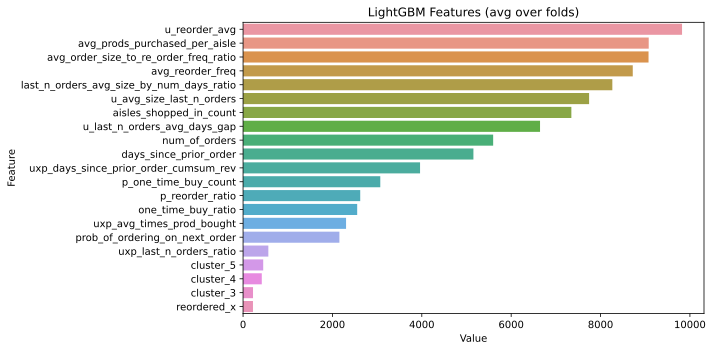

In [158]:
lgbm.feature_names = list(all_features_te.drop(columns = ['user_id','product_id']).columns)

import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# sorted(zip(clf.feature_importances_, X.columns), reverse=True)
feature_imp = pd.DataFrame(sorted(zip(lgbm.feature_importances_,lgbm.feature_names)), columns=['Value','Feature'])

plt.figure(figsize=(10, 5))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False))
plt.title('LightGBM Features (avg over folds)')
plt.tight_layout()
plt.show()
# plt.savefig('lgbm_importances-01.png')

**Choosing ideal threshold.**

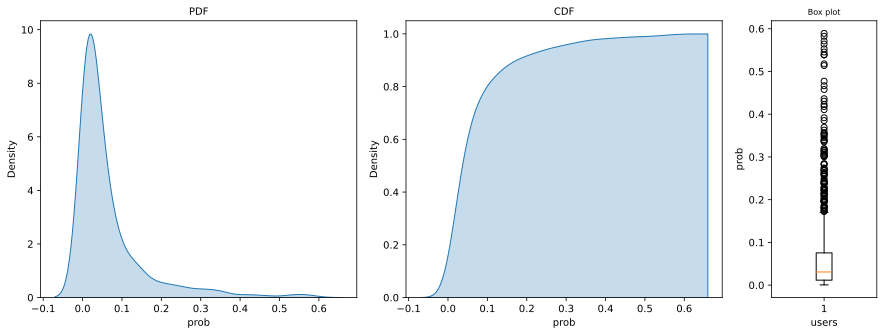

In [159]:
import random
univariate_analysis(random.sample(list(lgbm.predict_proba(X_test)[:, 1]), 1000), "prob")

**Observation/ Conclusion:**

* The mean is not centered as 0.50 thus we cannot predict all probabilities > 0.50 as will reorder and < 0.50 will not reorder.

* From the above plot we choose the threshold to be 0.18, using elbow method.

# **Testing on final evaluation dataset**

In [160]:
all_features_te

,user_id,product_id,reordered_x,num_of_orders,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,...,days_since_prior_order,u_avg_size_last_n_orders,last_n_orders_avg_size_by_num_days_ratio,p_reorder_ratio,p_one_time_buy_count,one_time_buy_ratio,uxp_last_n_orders_ratio,uxp_avg_times_prod_bought,prob_of_ordering_on_next_order,uxp_days_since_prior_order_cumsum_rev
0,3,248,0,12,12.487179,0.560575,16,5.500000,1,1,...,15.0,6.333333,0.478261,0.400251,2753.0,0.720492,0.0,0.083333,0.083333,133.0
1,3,1005,0,12,12.487179,0.560575,16,5.500000,1,1,...,15.0,6.333333,0.478261,0.440605,178.0,0.687259,0.2,0.083333,0.250000,43.0
2,3,1819,1,12,12.487179,0.560575,16,5.500000,1,1,...,15.0,6.333333,0.478261,0.492162,804.0,0.653128,0.0,0.250000,0.300000,64.0
3,3,7503,0,12,12.487179,0.560575,16,5.500000,1,1,...,15.0,6.333333,0.478261,0.553551,3432.0,0.616269,0.0,0.083333,0.090909,124.0
4,3,8021,0,12,12.487179,0.560575,16,5.500000,1,1,...,15.0,6.333333,0.478261,0.591157,6370.0,0.559164,0.0,0.083333,0.083333,133.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4833287,206208,48364,0,49,8.442105,1.539900,63,10.746032,0,2,...,7.0,17.333333,2.291667,0.530127,5387.0,0.587908,0.0,0.020408,0.020833,349.0
4833288,206208,48865,0,49,8.442105,1.539900,63,10.746032,0,2,...,7.0,17.333333,2.291667,0.394015,343.0,0.705761,0.0,0.020408,0.111111,48.0
4833289,206208,49247,0,49,8.442105,1.539900,63,10.746032,0,2,...,7.0,17.333333,2.291667,0.654641,1116.0,0.513576,0.0,0.020408,0.022222,329.0
4833290,206208,49385,0,49,8.442105,1.539900,63,10.746032,0,2,...,7.0,17.333333,2.291667,0.179245,220.0,0.842912,0.0,0.020408,0.041667,160.0


In [161]:
y_pred_final_te = (lgbm.predict_proba(all_features_te.drop(columns = ['user_id','product_id']).values)[:, 1] >= 0.18).astype('int') #setting a threshold.
y_pred_final_te[100:120]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [162]:
np.array(np.unique(y_pred_final_te, return_counts=True)).T

array([[      0, 4519374],
       [      1,  313918]])

In [163]:
final_te_dataset = all_features_te[['user_id','product_id']]
final_te_dataset['reordered_pred'] = y_pred_final_te

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [164]:
orders_test = orders_df[orders_df.eval_set=='test']
final_te_dataset = pd.merge(final_te_dataset, orders_test[["user_id", "order_id"]], on=['user_id'], how='left')
final_te_dataset.head()

,user_id,product_id,reordered_pred,order_id
0,3,248,0,2774568
1,3,1005,0,2774568
2,3,1819,0,2774568
3,3,7503,0,2774568
4,3,8021,0,2774568


In [165]:
final_te_dataset = final_te_dataset.drop(columns = ['user_id'])
final_te_dataset.head()

,product_id,reordered_pred,order_id
0,248,0,2774568
1,1005,0,2774568
2,1819,0,2774568
3,7503,0,2774568
4,8021,0,2774568


In [166]:
# DIMOS RAPTIS kaggle submission code snippet
result = dict()
for row in final_te_dataset.itertuples():
    if row.reordered_pred == 1:
        try:
            result[row.order_id] += ' ' + str(row.product_id)
        except:
            result[row.order_id] = str(row.product_id)

for order in final_te_dataset.order_id:
    if order not in result:
        result[order] = 'None'
        

In [167]:
submission = pd.DataFrame.from_dict(result, orient='index').reset_index()
submission.columns = ['order_id', 'products']
submission.to_csv('/content/submission.csv', index=False)

In [168]:
submission = pd.read_csv("/content/submission.csv")
submission.head()

,order_id,products
0,2774568,18599 21903 39190 43961 47766
1,1528013,21903 38293
2,1376945,8309 13176 14947 27959 33572
3,1356845,7076 10863 13176
4,2161313,196 10441 12427 37710
